In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import os
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sb
import scrublet 
from matplotlib.pyplot import rc_context
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams["font.sans-serif"] = "Arial"
%config InlineBackend.figure_format = 'retina'
sc.settings.set_figure_params(dpi=50, dpi_save=300, figsize=(5, 5),color_map='Reds')

In [487]:
os.chdir('/disk212/yupf/database/scRNA-seq/NewAtlas')
concat_file='./atlas_concat.h5ad'
QC_file='./atlas_qc.h5ad'
reduction_file = './atlas_rd.h5ad'
harmony_file='./atlas_harm.h5ad'
scVI_file='./atlas_scvi.h5ad'
level1_annotation_file ='./atlas_level1.h5ad'
level2_annotation_file ='./atlas_level2.h5ad'

In [3]:
adata=sc.read_h5ad(level1_annotation_file)

In [4]:
adata.obs['Lineage']

AAACCCAAGAGTTGAT-1_CNP0002165                    B lineage
AAACCCAAGCAACTTC-1_CNP0002165                    B lineage
AAACCCAAGCAGTCTT-1_CNP0002165           Epithelial lineage
AAACCCAAGCGCATCC-1_CNP0002165                    B lineage
AAACCCAAGGGTAGCT-1_CNP0002165                    B lineage
                                               ...        
TTTGTTGCAATCGCCG-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTACCTAGT-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTACTAAGA-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTTTCGCTC-1_PRJNA859792_NoPP4    Epithelial lineage
TTTGTTGTCAGTGTCA-1_PRJNA859792_NoPP4         T/ILC lineage
Name: Lineage, Length: 589101, dtype: category
Categories (7, object): ['B lineage', 'Endothelial lineage', 'Epithelial lineage', 'Mesenchymal lineage', 'Myeloid lineage', 'T/ILC lineage', 'Neuron Lineage']

## level3 annotation

### EPI

In [5]:
epi=adata[adata.obs['Lineage']=='Epithelial lineage']

In [6]:
epi

View of AnnData object with n_obs × n_vars = 181422 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

2023-09-10 21:45:19.997971: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-10 21:45:21.621853: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-09-10 21:45:21.751397: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-09-10 21:45:21.751439: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore 

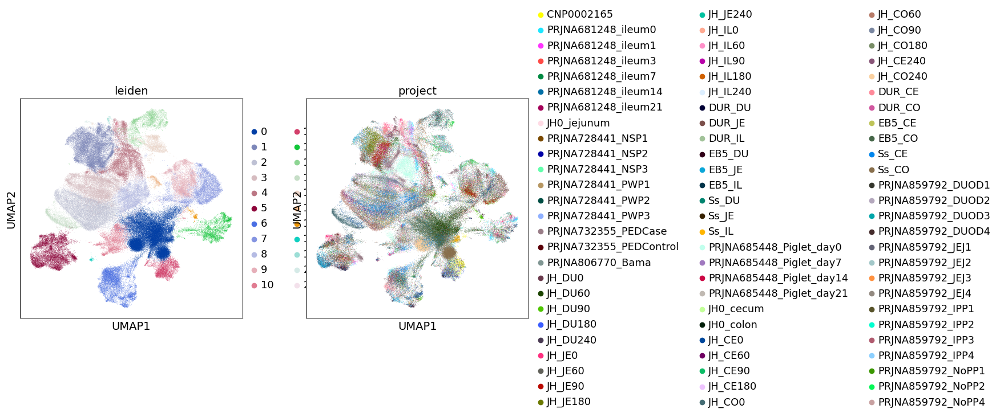

In [16]:
sc.pp.neighbors(epi, use_rep = 'X_scVI')
sc.tl.umap(epi)
sc.tl.leiden(epi, resolution = 0.5)
sc.pl.umap(epi, color=['leiden','project'])

#### stem

LGR5 is in epi.var_names
OLFM4 is in epi.var_names
TOP2A is in epi.var_names
HMGB2 is in epi.var_names


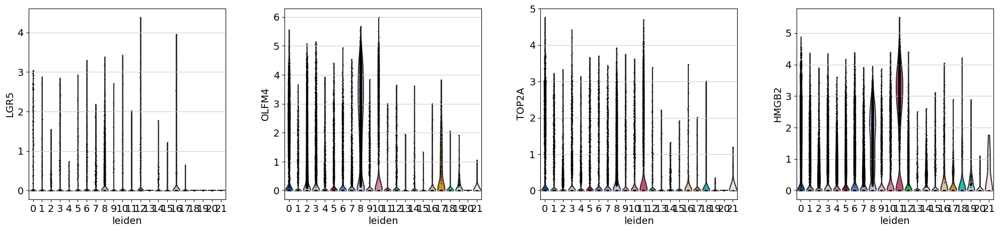

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


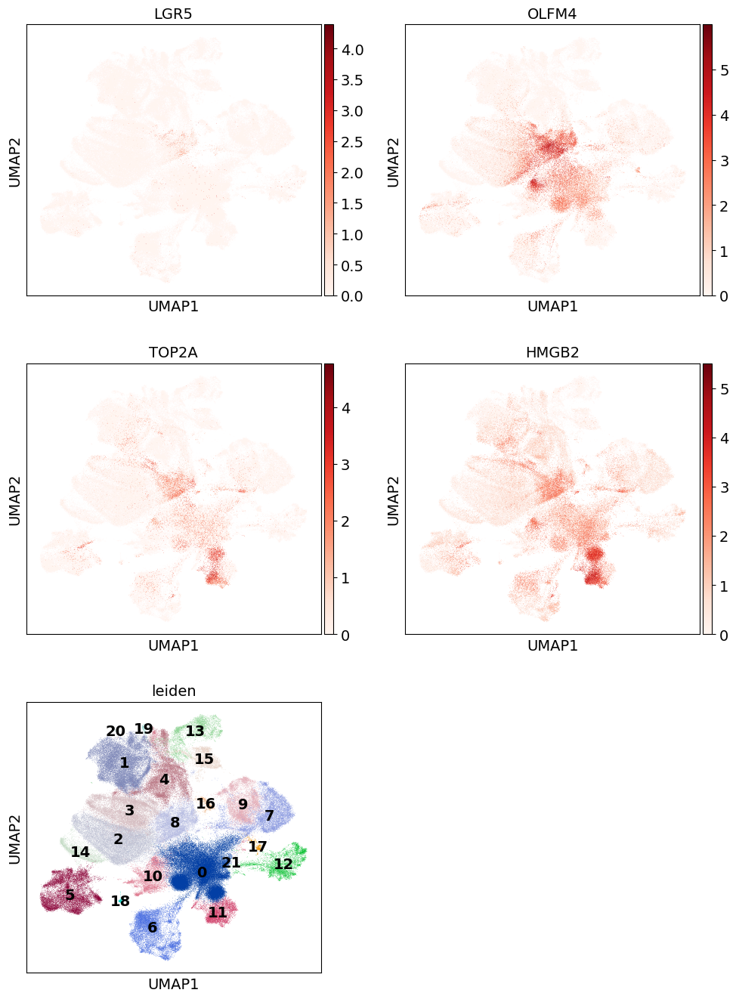

In [103]:
##Stem cells 可分化为Progenitor和TA
# Glist=['LGR5','SMOC2','RGMB','AXIN2']
# Glist=['LGR5','ASCL2','SLC12A2','RGMB']
Glist=['LGR5',"OLFM4",'TOP2A','HMGB2']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_Stem_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_Stem_feature.pdf')

#### TA

TOP2A is in epi.var_names
PCNA is in epi.var_names
DUT is in epi.var_names
UBE2C is in epi.var_names


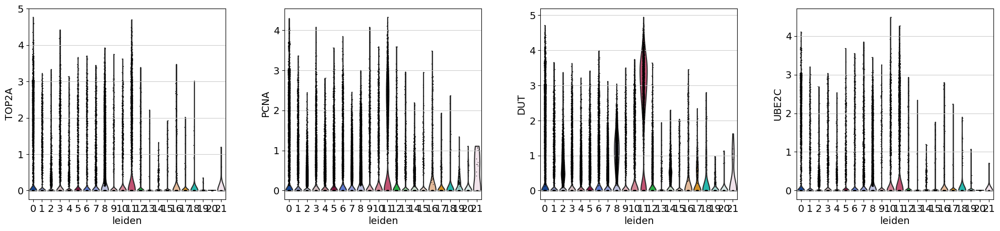

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


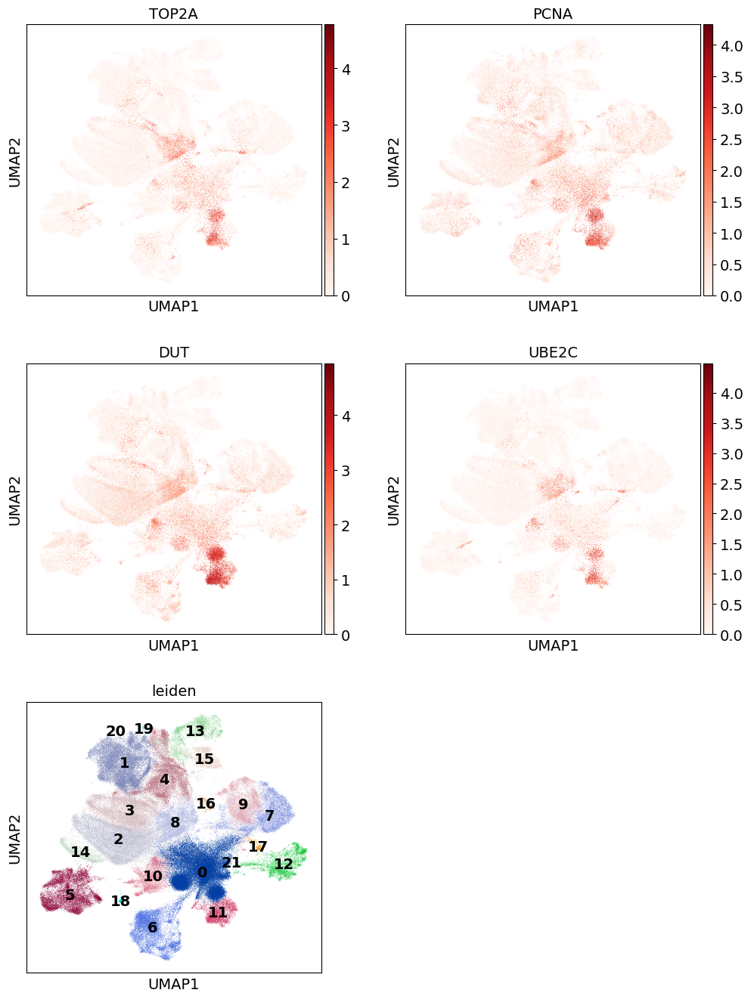

In [106]:
##TA: transit-amplifying
Glist=['TOP2A','PCNA','DUT',"UBE2C"]
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_TA_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_TA_feature.pdf')

#### paneth

PIGR is in epi.var_names
MMP7 is in epi.var_names
CPSF6 is in epi.var_names


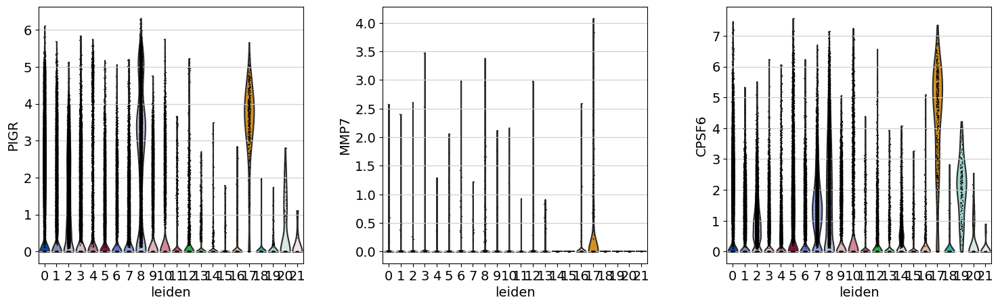

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


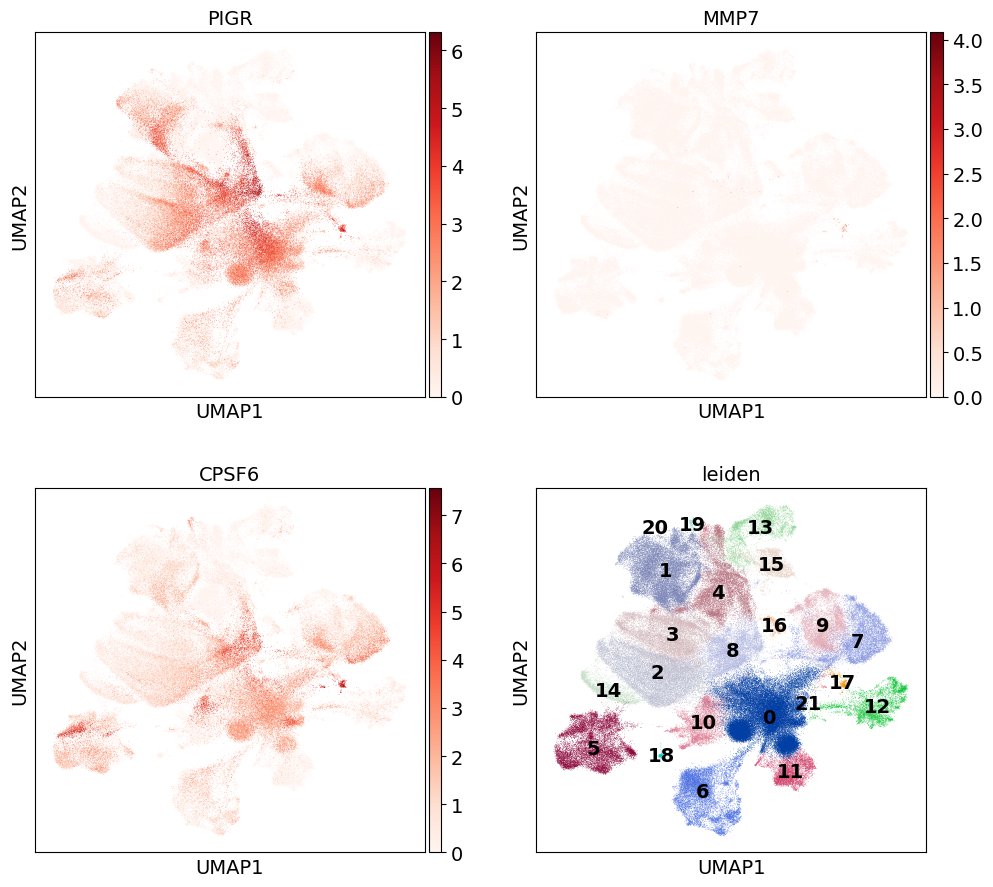

In [107]:
#Paneth cells
Glist=['PIGR','MMP7','CPSF6']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_Paneth_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_Paneth_feature.pdf')

#### Microfold

SPIB is not in epi.var_names
CCL20 is not in epi.var_names
GP2 is in epi.var_names
GUCY2C is not in epi.var_names


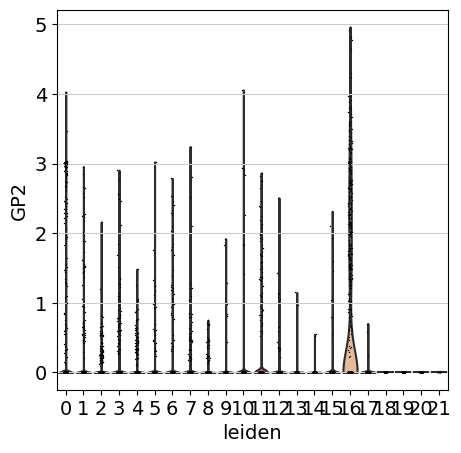

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


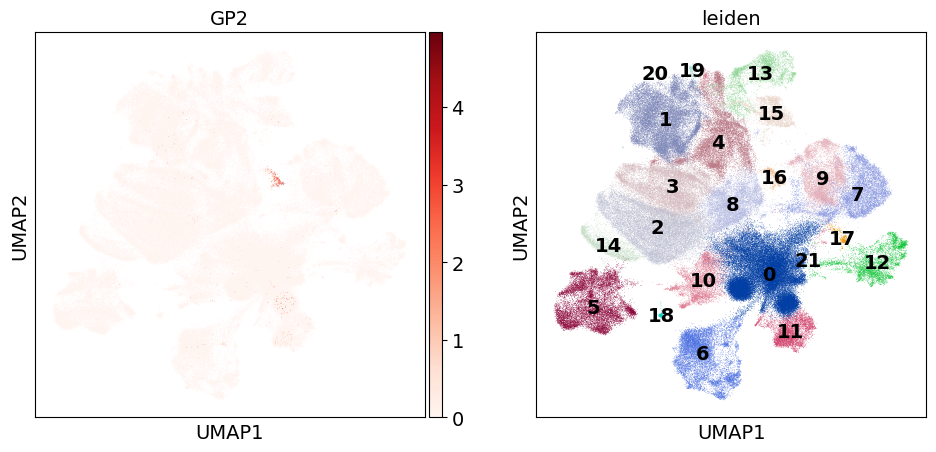

In [108]:
#Microfold
Glist=['SPIB','CCL20','GP2','GUCY2C']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_Microfold_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_Microfold_feature.pdf')

#### Goblet cells

CLCA1 is in epi.var_names
SPDEF is in epi.var_names
TFF3 is in epi.var_names
REG4 is in epi.var_names
SPINK4 is in epi.var_names
CXCL8 is in epi.var_names


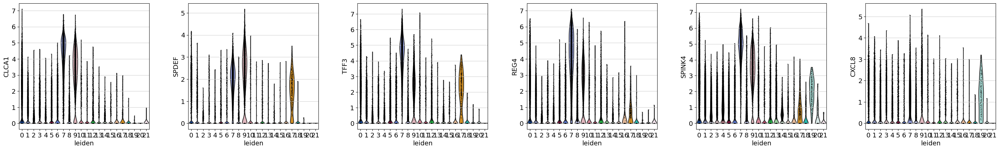

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


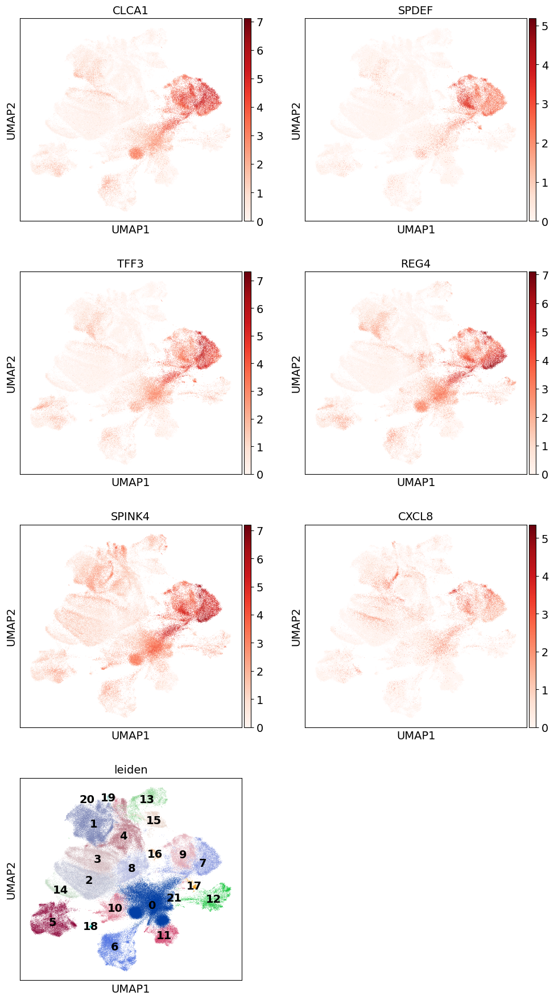

In [109]:
##Goblet cells
Glist=['CLCA1','SPDEF', 'TFF3','REG4','SPINK4','CXCL8']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_Goblet_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_Goblet_feature.pdf')

#### Tuft

POU2F3 is in epi.var_names
IRAG2 is in epi.var_names


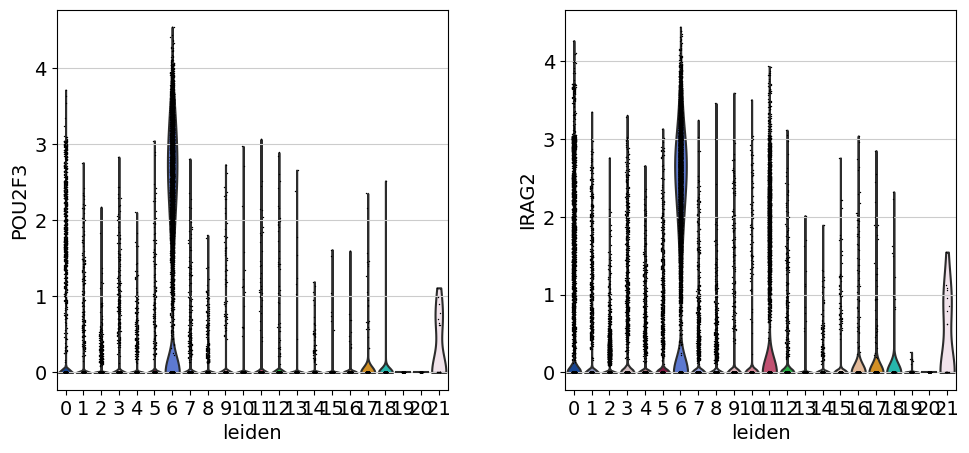

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


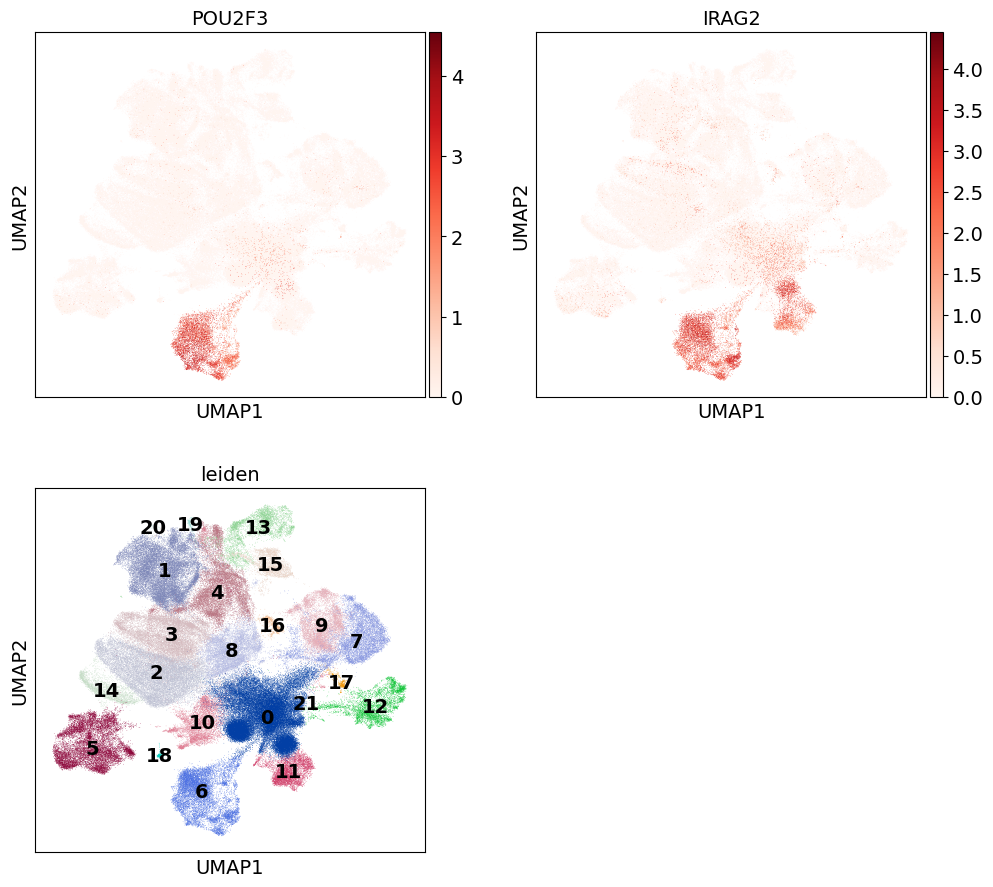

In [110]:
##Tuft
Glist=['POU2F3','IRAG2']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_Tuft_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_Tuft_feature.pdf')

#### BEST4 enterocytes

BEST4 is in epi.var_names
OTOP2 is in epi.var_names
CFTR is in epi.var_names
NOTCH2 is in epi.var_names
CA7 is in epi.var_names


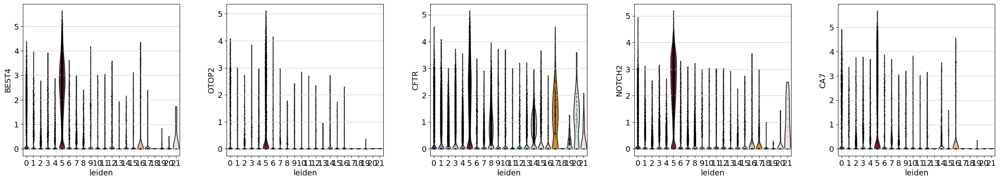

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


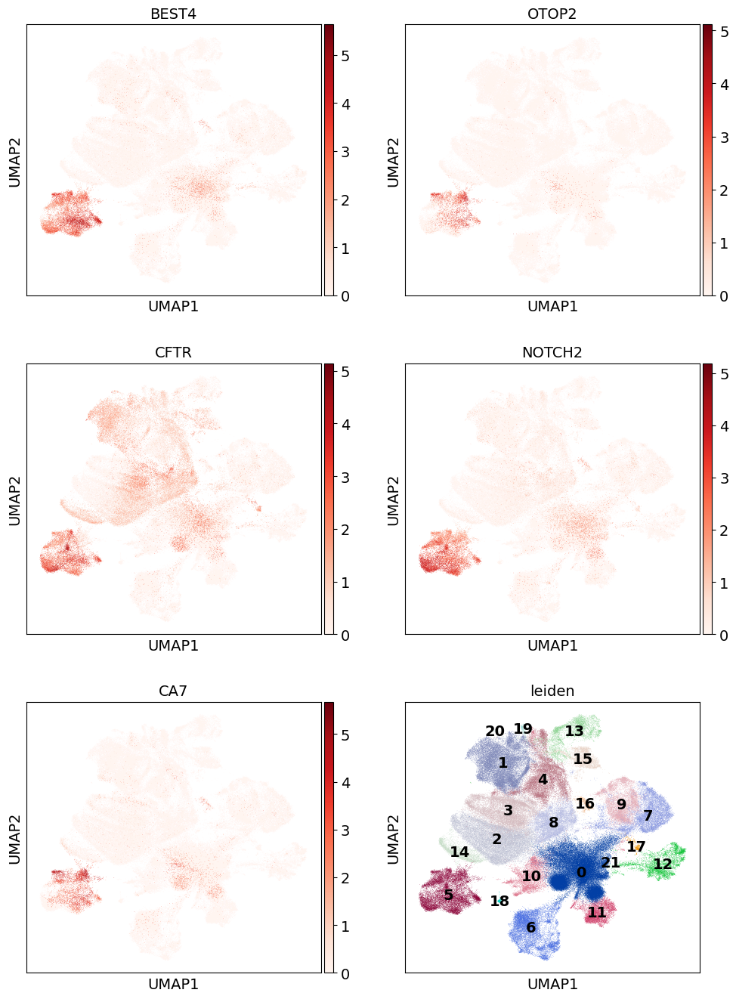

In [111]:
##BEST4 enterocytes
Glist=['BEST4', 'OTOP2','CFTR','NOTCH2','CA7']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_BEST4_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_BEST4_feature.pdf')

#### Enterocytes

RBP2 is in epi.var_names
ANPEP is in epi.var_names
FABP2 is in epi.var_names


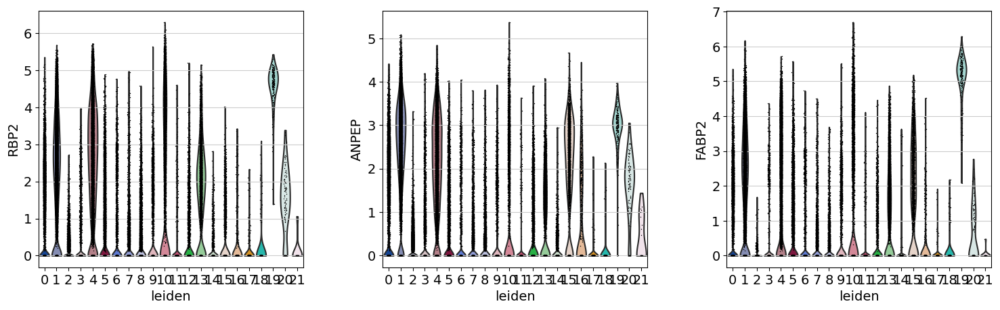

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


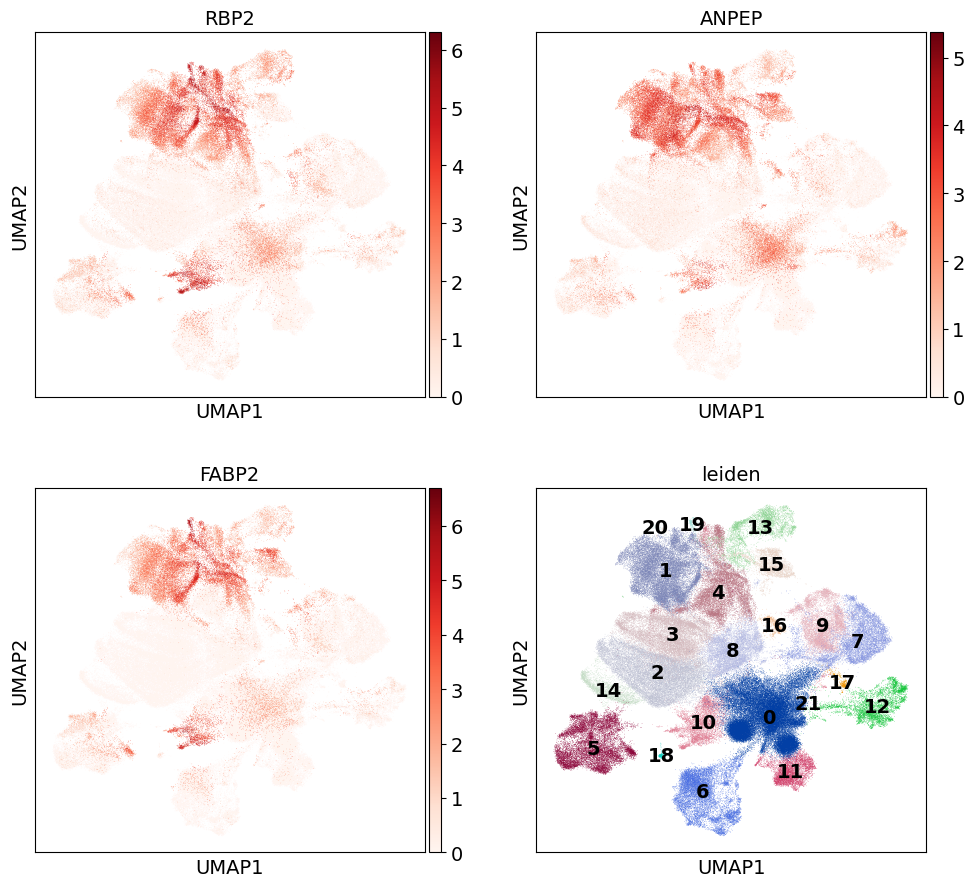

In [112]:
##Enterocytes
Glist=['RBP2', 'ANPEP', 'FABP2']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_Enterocytes_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_Enterocytes_feature.pdf')

#### coloncyte

CA2 is in epi.var_names
SLC26A2 is in epi.var_names
ENSSSCG00000008214 is in epi.var_names


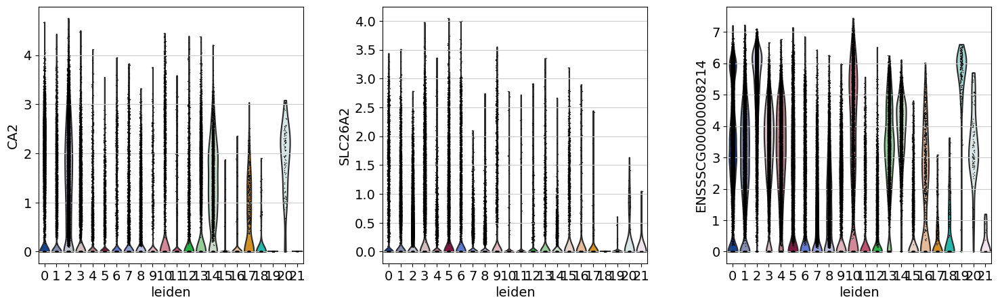

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


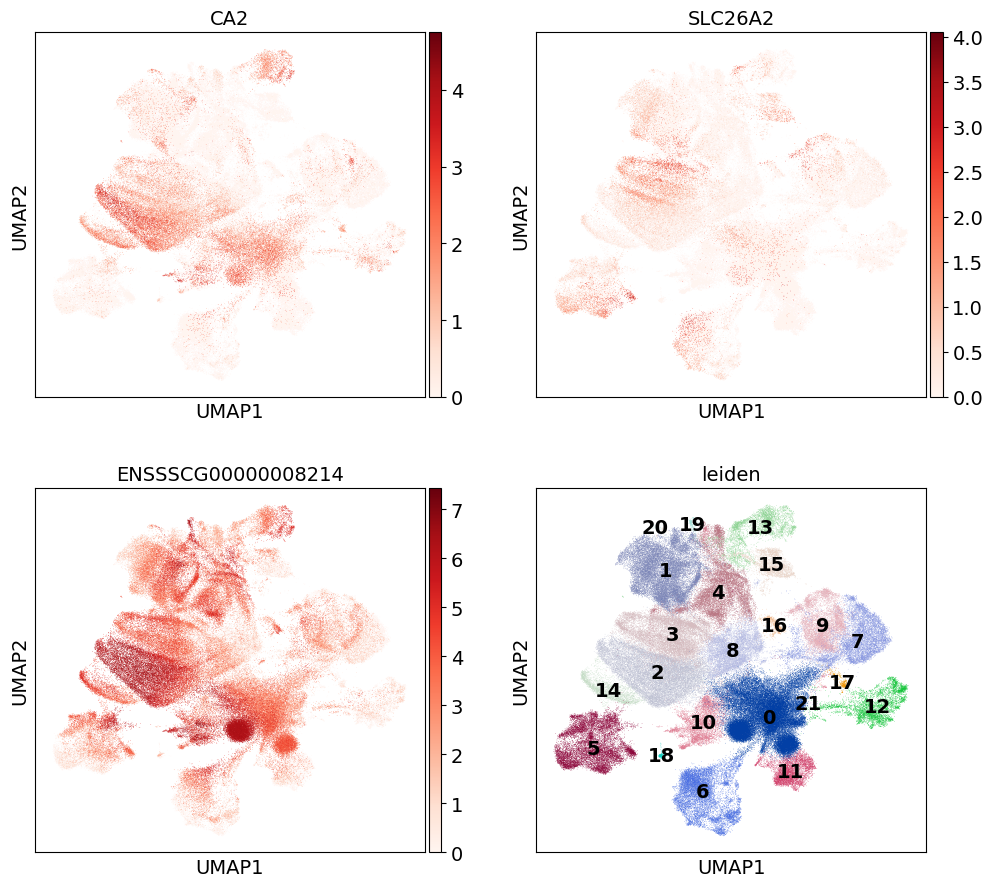

In [113]:
##coloncytes
Glist=['CA2', 'SLC26A2', 'ENSSSCG00000008214']#'FABP1'
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_coloncytes_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_coloncytes_feature.pdf')

#### EEC

CHGA is in epi.var_names
CHGB is in epi.var_names
NEUROD1 is in epi.var_names


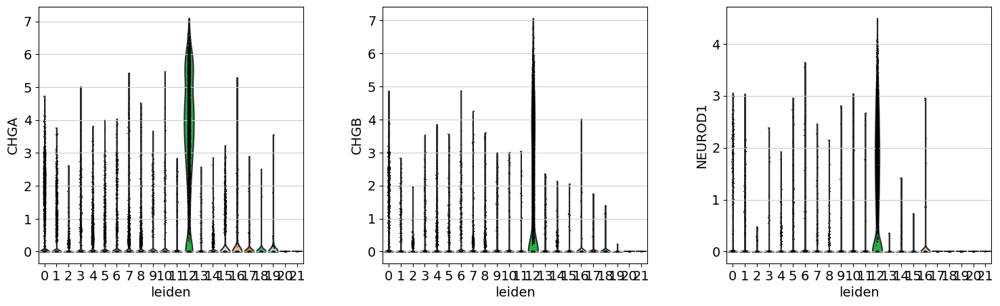

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


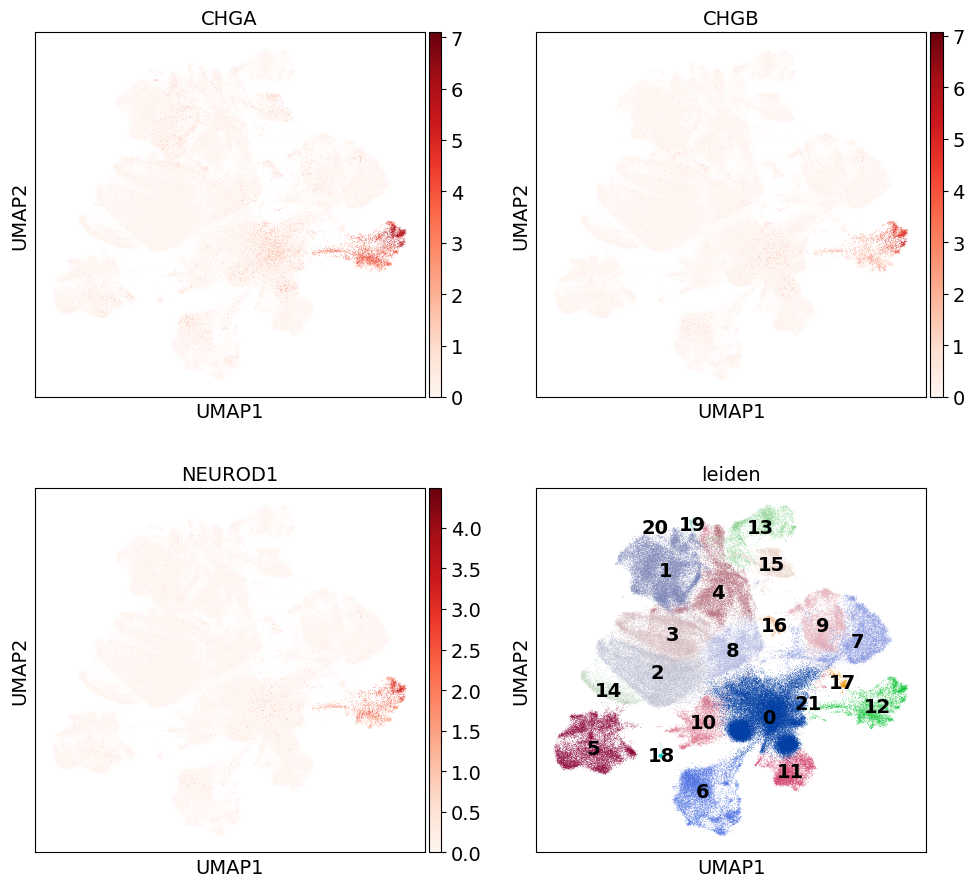

In [114]:
##EEC: Endometrial epi Cells
Glist=['CHGA','CHGB','NEUROD1']
for i in Glist[:]:
    if i  in epi.var_names:
        print(i+' is in epi.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in epi.var_names')
sc.pl.violin(epi, keys=Glist,groupby='leiden',save='_EEC_violin.pdf')
Glist.append('leiden')
sc.pl.umap(epi, color=Glist,legend_loc='on data',ncols=2,save='_EEC_feature.pdf')

#### annotation

In [66]:
def function(a):
    if a in ['1','4','10','13','15','19','20']:
        return "Enterocytes"
    if a in ['2','3','14']:
        return "Coloncytes"
    elif a in ['5']:
        return "BEST4 enterocytes"
    elif a in ['6']:
        return "Tuft"
    elif a in ['17']:
        return "Paneth"
    elif a in ['16']:
        return "Microfold"
    elif a in ['7','9']:
        return "Goblet"
    elif a in ['12']:
        return "EECs"
    elif a in ['11']:
        return "TA"
    elif a in ['8']:
        return "stem"
    elif a in ['5']:
        return "Progenitors"
    elif a in ['0']:
        return "mass"
    elif a in ['18']:
        return "unknown_18"
    elif a in ['21']:
        return "unknown_21"
df = epi.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
epi.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


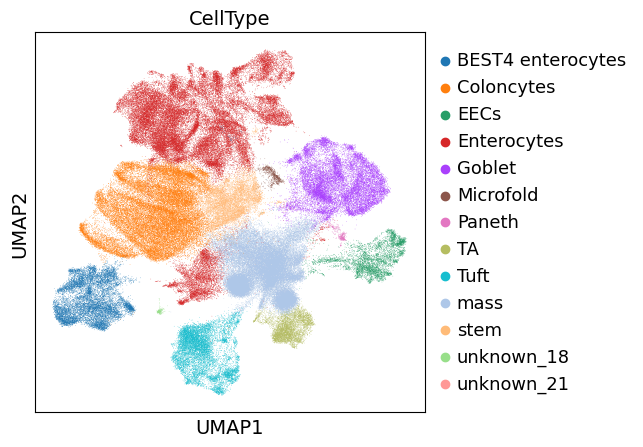

In [67]:
sc.pl.umap(epi, color=["CellType"])

#### mass

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


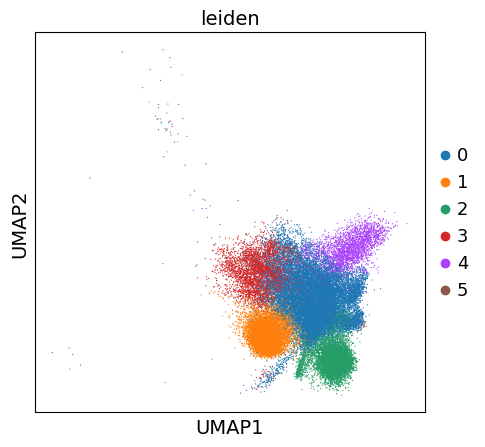

In [51]:
mass=epi[epi.obs['CellType']=='mass']
sc.tl.leiden(mass, resolution = 0.3)
sc.pl.umap(mass, color=['leiden'])

##### MASS_TA

TOP2A is in mass.var_names
PCNA is in mass.var_names
DUT is in mass.var_names
UBE2C is in mass.var_names


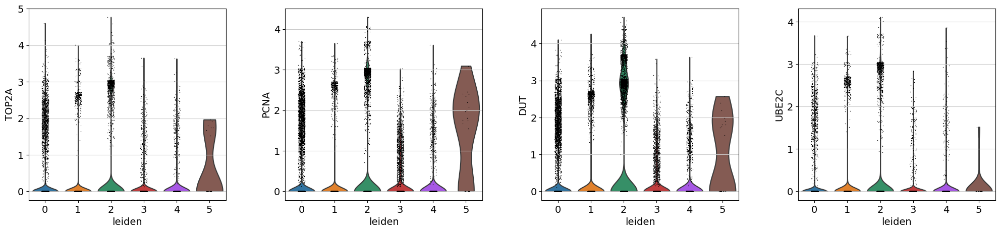

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


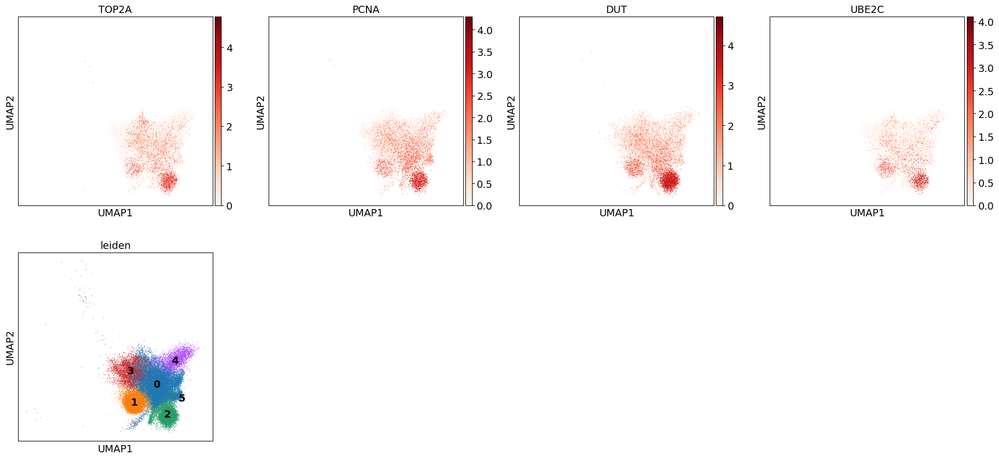

In [52]:
##TA: transit-amplifying
Glist=['TOP2A','PCNA','DUT',"UBE2C"]
for i in Glist[:]:
    if i  in mass.var_names:
        print(i+' is in mass.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mass.var_names')
sc.pl.violin(mass, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mass, color=Glist,legend_loc='on data')

##### MASS_GOBLET

CLCA1 is in mass.var_names
SPDEF is in mass.var_names
TFF3 is in mass.var_names
REG4 is in mass.var_names
SPINK4 is in mass.var_names
CXCL8 is in mass.var_names


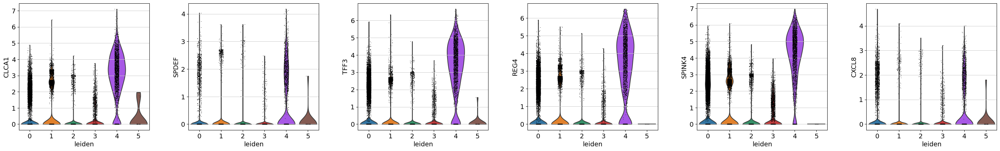

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


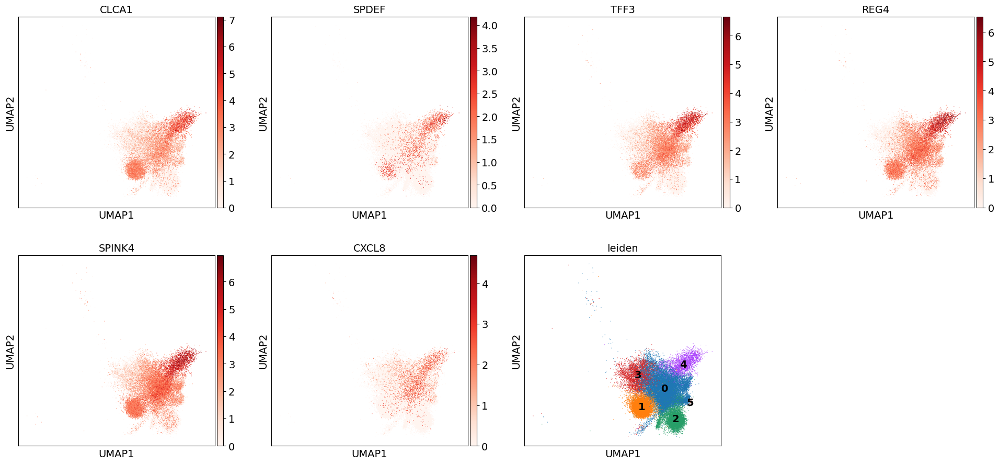

In [54]:
##Goblet cells
Glist=['CLCA1','SPDEF', 'TFF3','REG4','SPINK4','CXCL8']
for i in Glist[:]:
    if i  in mass.var_names:
        print(i+' is in mass.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mass.var_names')
sc.pl.violin(mass, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mass, color=Glist,legend_loc='on data')

##### MASS_IMMATURE

OLFM4 is in mass.var_names
TOP2A is in mass.var_names
HMGB2 is in mass.var_names


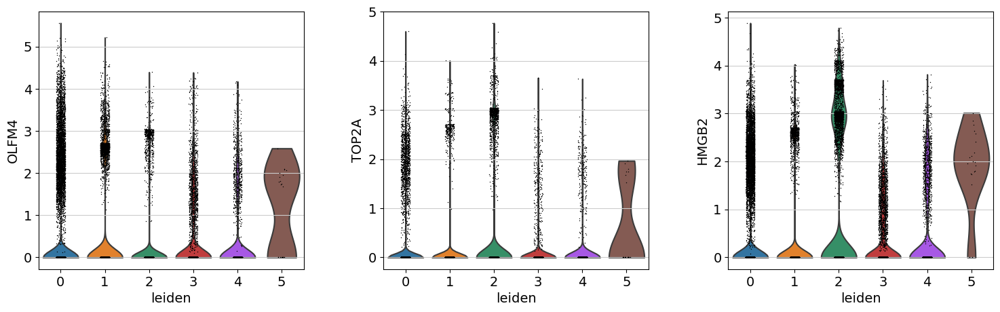

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


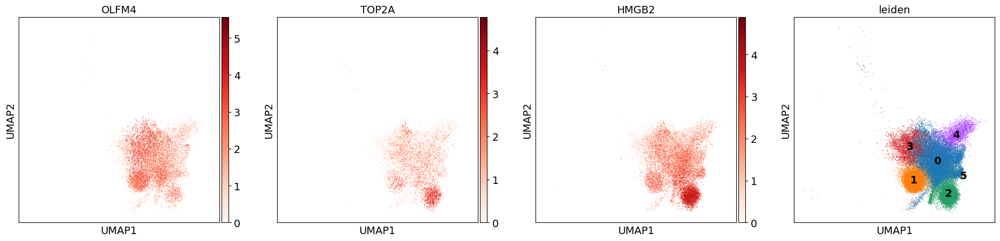

In [57]:
Glist=["OLFM4",'TOP2A','HMGB2']
for i in Glist[:]:
    if i  in mass.var_names:
        print(i+' is in mass.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mass.var_names')
sc.pl.violin(mass, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mass, color=Glist,legend_loc='on data')

##### MASS_ANNOTATION

In [76]:
def function(a):
    if a in ['0','1','3','5']:
        return "Immature Enterocytes"
    elif a in ['2']:
        return "TA"
    elif a in ['4']:
        return "Goblet"
df = mass.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mass.obs=df 
#跨列操作，与axis=0对应

In [68]:
epi.obs['CellType'] = epi.obs['CellType'].cat.add_categories('Immature Enterocytes')

In [77]:
epi.obs.loc[mass.obs_names,'CellType'] = mass.obs['CellType'].astype('object')
epi.obs['CellType'] = epi.obs['CellType'].cat.remove_unused_categories()

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


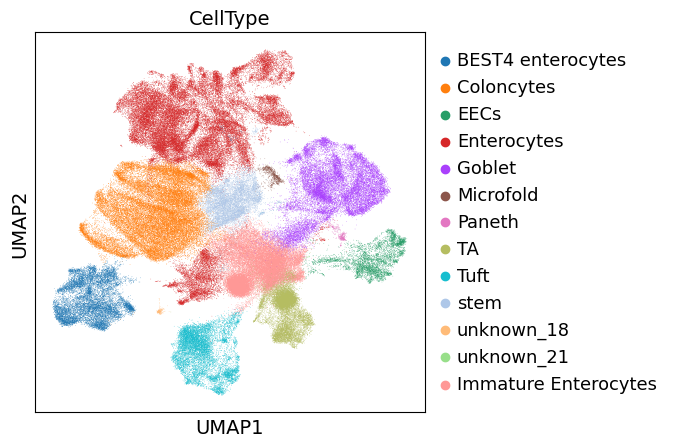

In [78]:
sc.pl.umap(epi, color=["CellType"])

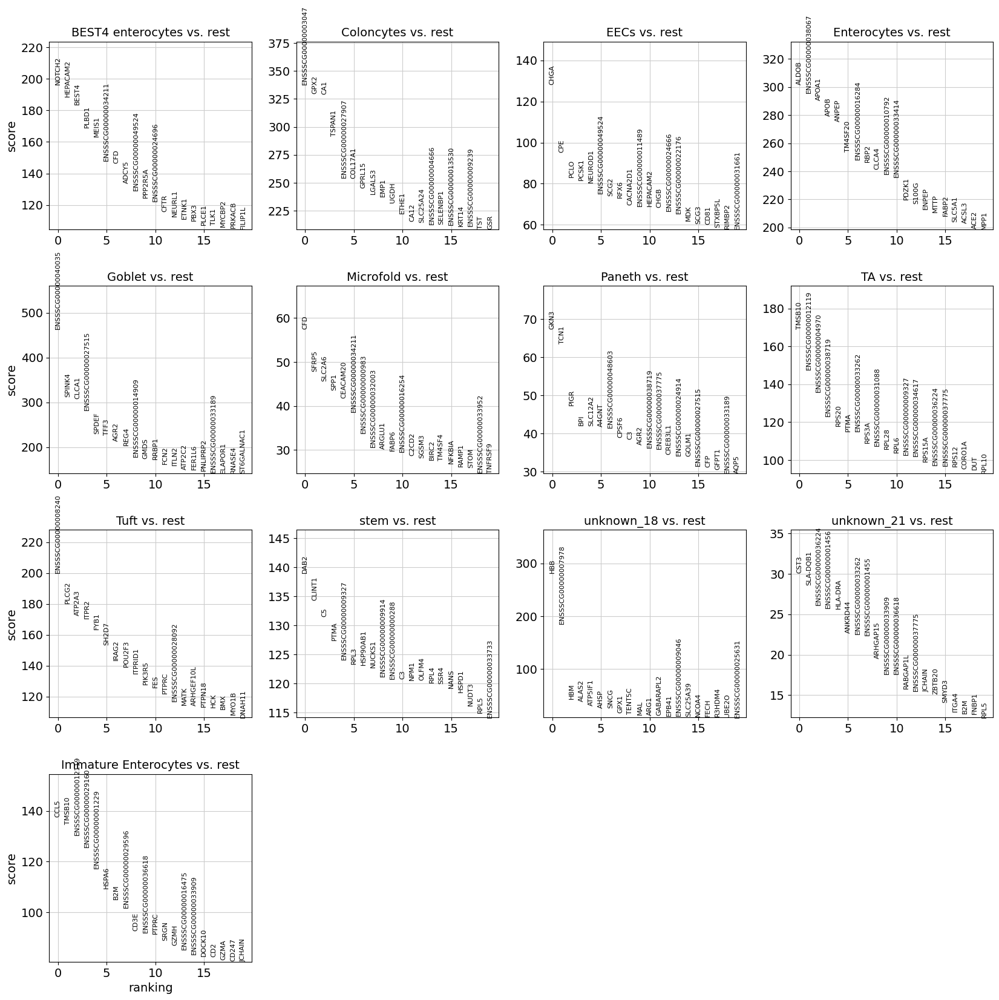

In [79]:
sc.tl.rank_genes_groups(epi, 'CellType',n_genes=20)
sc.pl.rank_genes_groups(epi, n_genes=20, sharey=False)

In [84]:
epi.obs['CellType'] = epi.obs['CellType'].replace('unknown_21', 'lym??')
epi.obs['CellType'] = epi.obs['CellType'].replace('unknown_18', 'red blood??')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


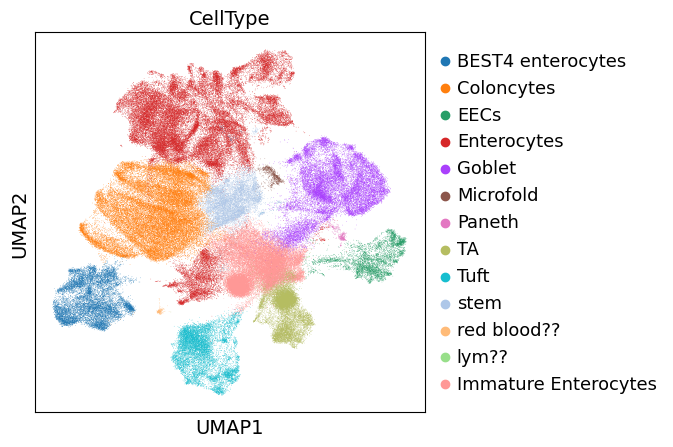

In [85]:
sc.pl.umap(epi, color=["CellType"])

In [86]:
adata

AnnData object with n_obs × n_vars = 589101 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### ingest to adata

In [261]:
adata.obs["CellType"] = pd.Series(dtype="category")
adata_celltypes = np.unique(adata.obs['CellType'])
epi_celltypes = np.unique(epi.obs['CellType'])

# 检查 rpi.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(epi_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType'] = adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [262]:
adata.obs.loc[epi.obs_names,'CellType'] = epi.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


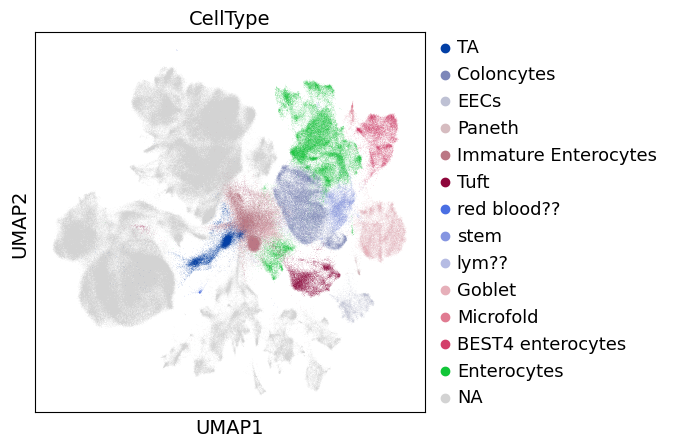

In [263]:
sc.pl.umap(adata,color='CellType')

In [94]:
epi.write('./epi.h5ad')

### T

In [421]:
adata

AnnData object with n_obs × n_vars = 589101 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

In [419]:
T=adata[adata.obs['Lineage']=='T/ILC lineage']
# T=sc.read_h5ad('./T.h5ad')

In [420]:
T

View of AnnData object with n_obs × n_vars = 184349 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### CD4 T cells

CD4 is in T.var_names


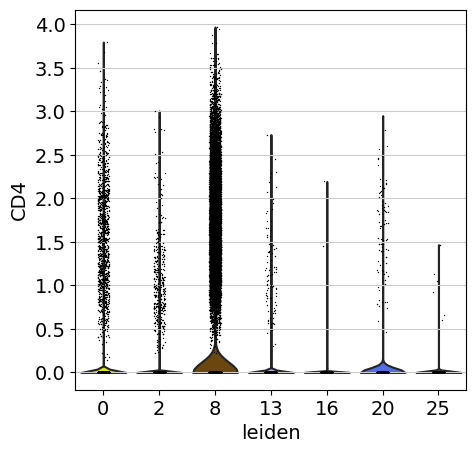

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


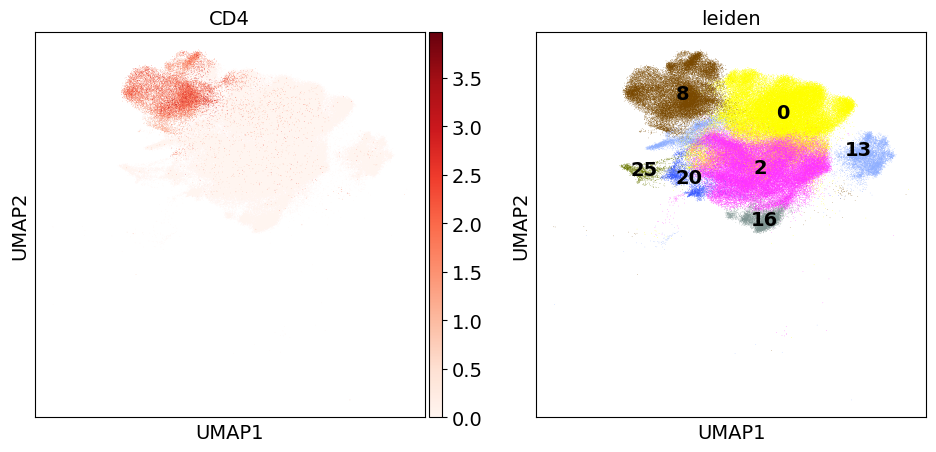

In [377]:
Glist=['CD4']#CD4 T cells
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

#### CD8 T cells

CD8B is in T.var_names


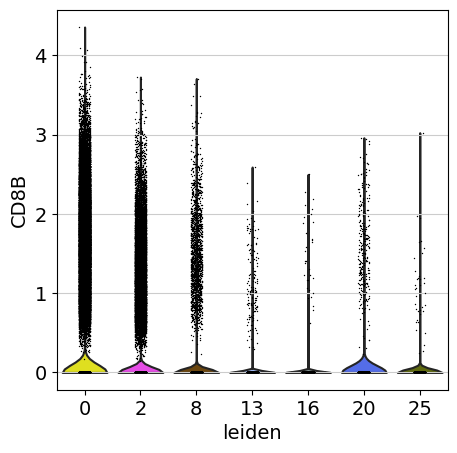

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


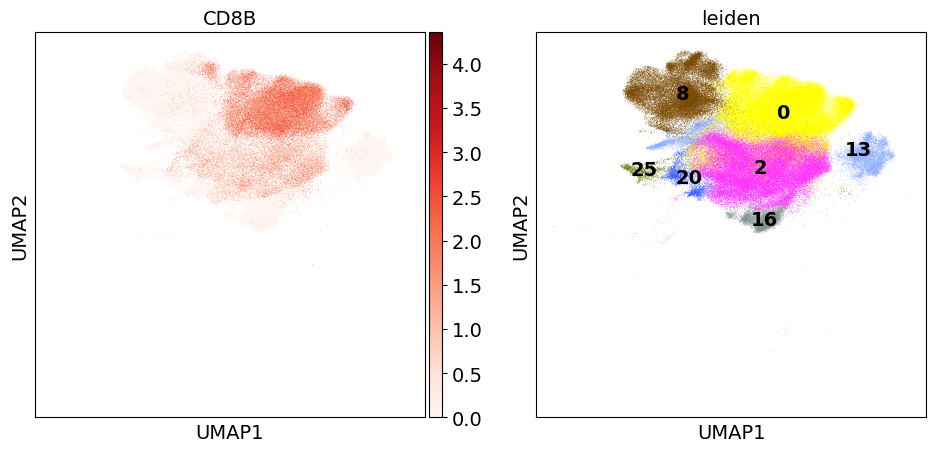

In [373]:
Glist=['CD8B','CD8A']#CD8 T cells
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

#### NK cells

EOMES is in T.var_names
KIR is not in T.var_names
NKG7 is in T.var_names
PRF1 is in T.var_names
GZMB is not in T.var_names


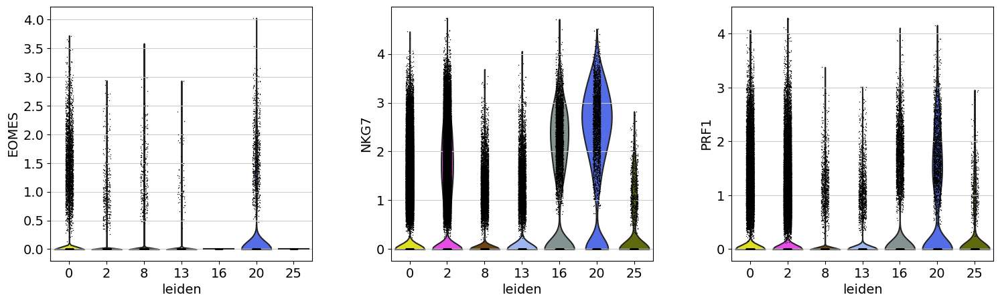

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


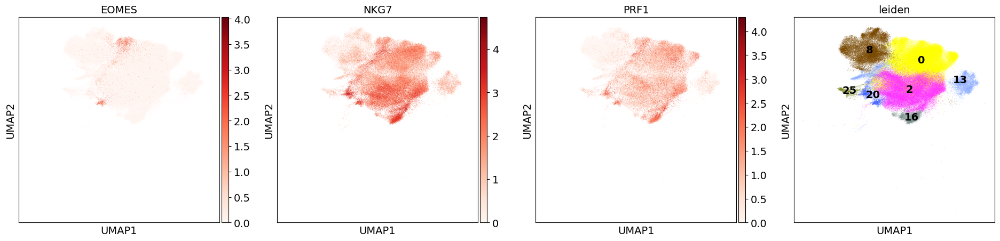

In [396]:
Glist=['EOMES','KIR','NKG7','PRF1','GZMB']#NK cells
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

#### ILC

##### ILC1

EOMES is in T.var_names
ENSSSCG00000037364 is in T.var_names


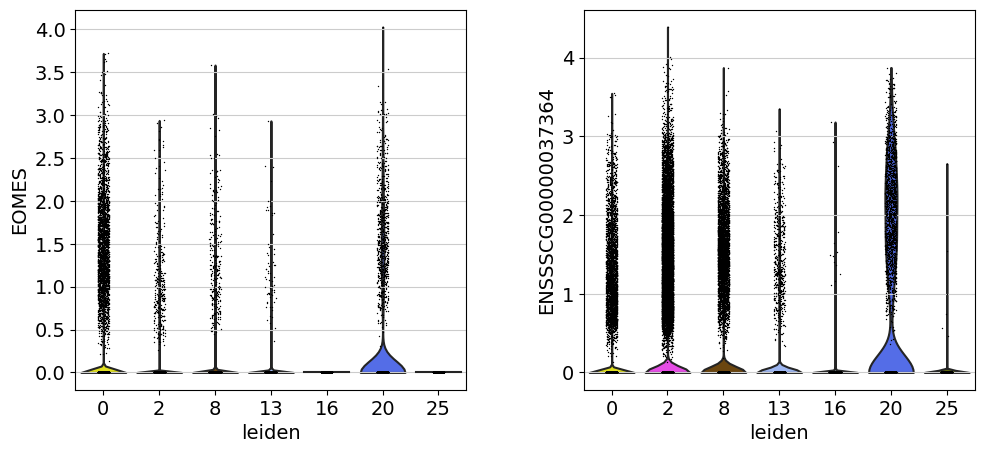

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


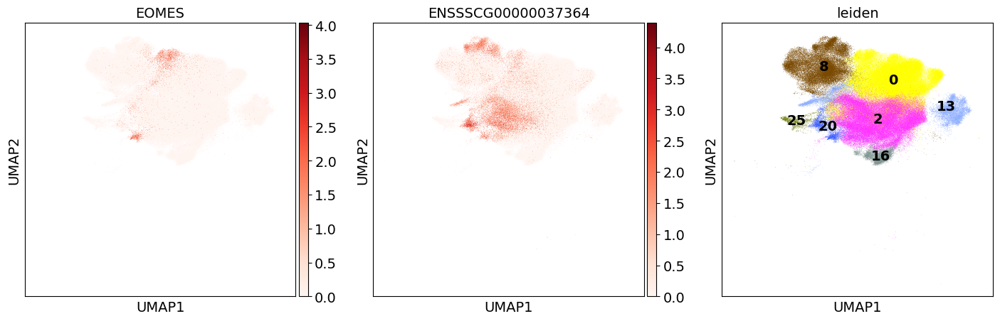

In [408]:
Glist=['EOMES','ENSSSCG00000037364']#CD7
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

##### ILC2

GATA3 is in T.var_names
PTGDR2 is in T.var_names
RORA is in T.var_names


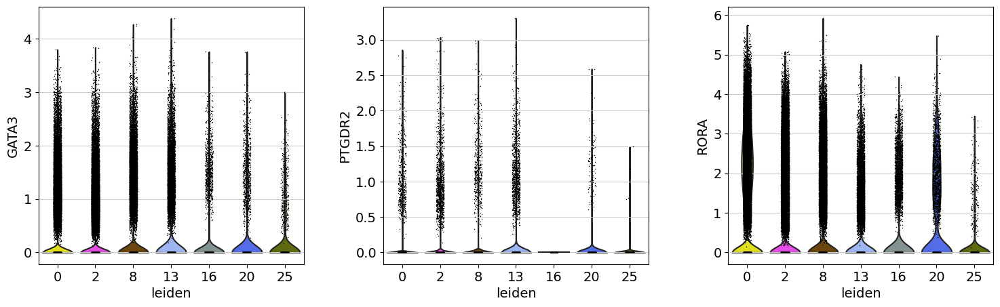

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


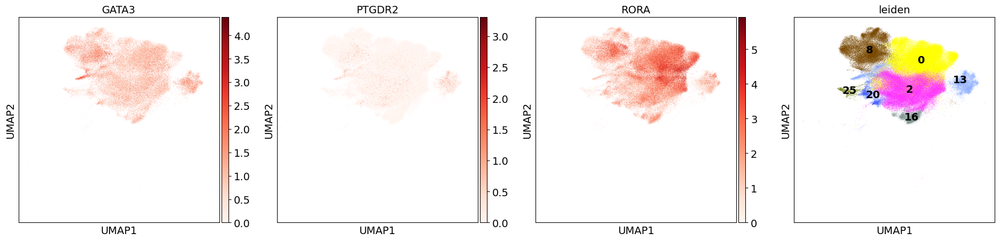

In [407]:
Glist=['GATA3','PTGDR2']
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

KLRB1 is in T.var_names
CXCL2 is in T.var_names
RORC is in T.var_names
KIT is in T.var_names
ENSSSCG00000037364 is in T.var_names
IL7R is in T.var_names


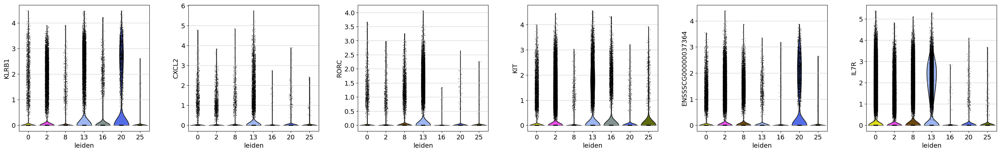

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


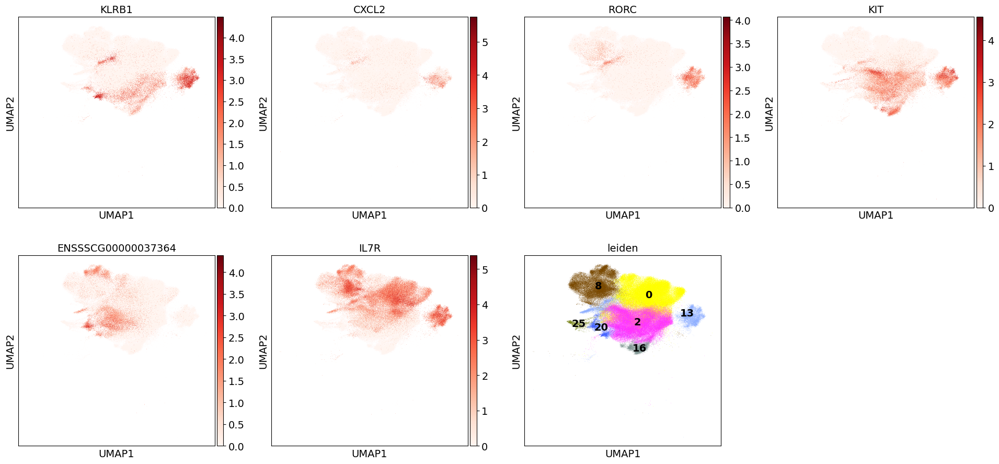

In [403]:
Glist=['KLRB1','CXCL2','RORC','KIT']#ILC _LACK CD3E _high CD2
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

#### RANK gene

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


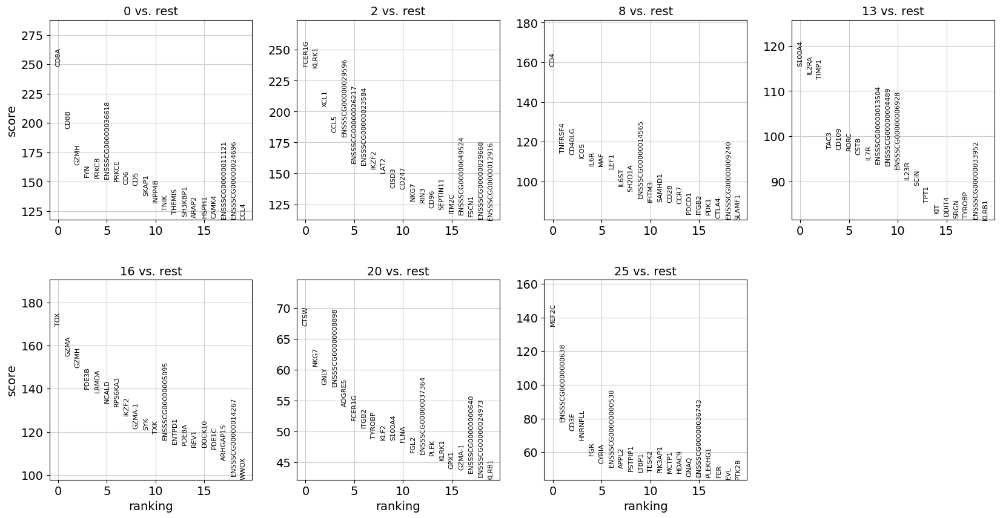

In [118]:
sc.tl.rank_genes_groups(T, 'leiden',n_genes=20)
sc.pl.rank_genes_groups(T, n_genes=20, sharey=False)

#### annotation

In [433]:
def function(a):
    if a in ['0','2']:
        return "CD8 T cells"
    elif a in ['8']:
        return "CD4 T cells"
    elif a in ['20']:
        return "ILC1"
    elif a in ['13']:
        return "ILC_mass"
    elif a in ['16']:
        return "Tex??"
    elif a in ['25']:
        return "Th"#MEF2C
df = T.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
T.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


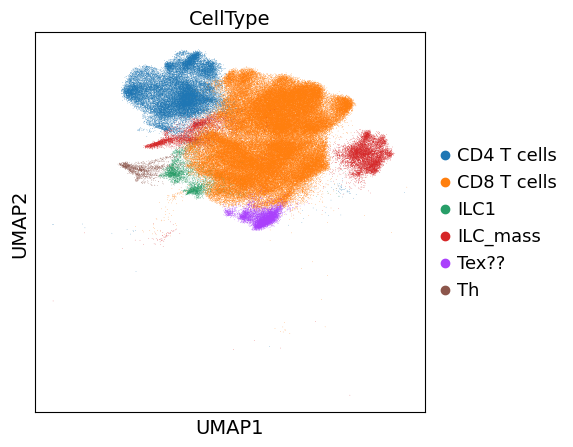

In [434]:
sc.pl.umap(T, color=["CellType"])

In [435]:
T.write('./T.h5ad')

#### ingest to adata

In [436]:
adata.obs['CellType'] = adata.obs['CellType'].astype(str)
adata_celltypes = np.unique(adata.obs['CellType'])
T_celltypes = np.unique(T.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(T_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [438]:
adata.obs.loc[T.obs_names,'CellType'] = T.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


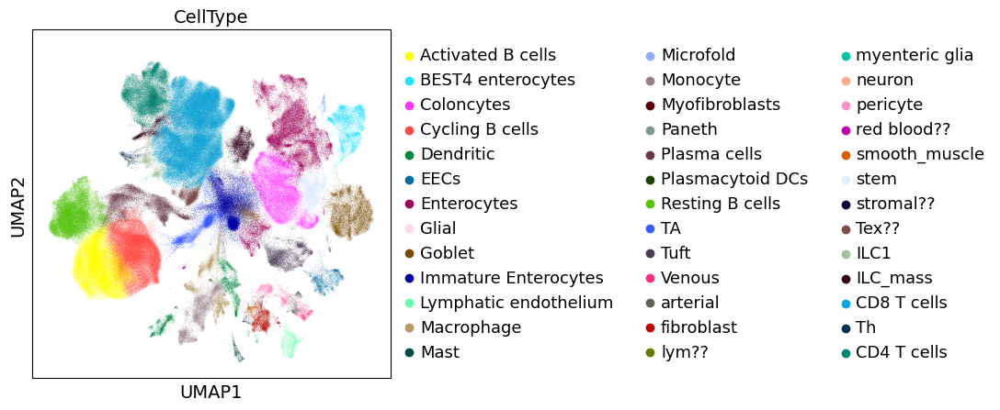

In [439]:
sc.pl.umap(adata,color='CellType')

### B

In [122]:
B=adata[adata.obs['Lineage']=='B lineage']

In [123]:
B

View of AnnData object with n_obs × n_vars = 176493 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### plasma

JCHAIN is in B.var_names
XBP1 is in B.var_names
IRF4 is in B.var_names
PRDM1 is in B.var_names


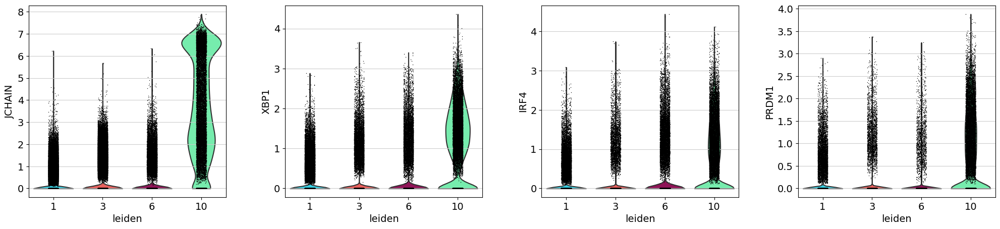

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


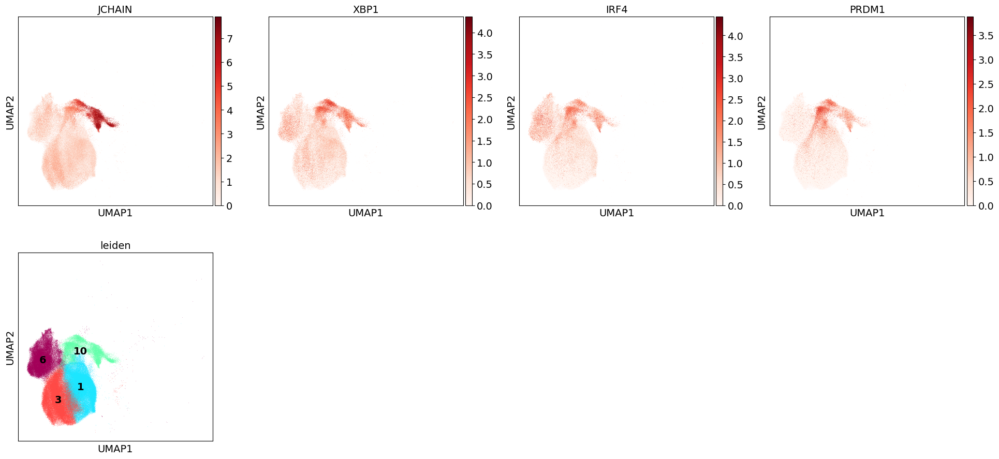

In [124]:
Glist=['JCHAIN','XBP1','IRF4','PRDM1']
for i in Glist[:]:
    if i  in B.var_names:
        print(i+' is in B.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in B.var_names')
sc.pl.violin(B, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(B, color=Glist,legend_loc='on data')

#### Resting B

KLF2 is in B.var_names
SELL is in B.var_names
CCR7 is in B.var_names


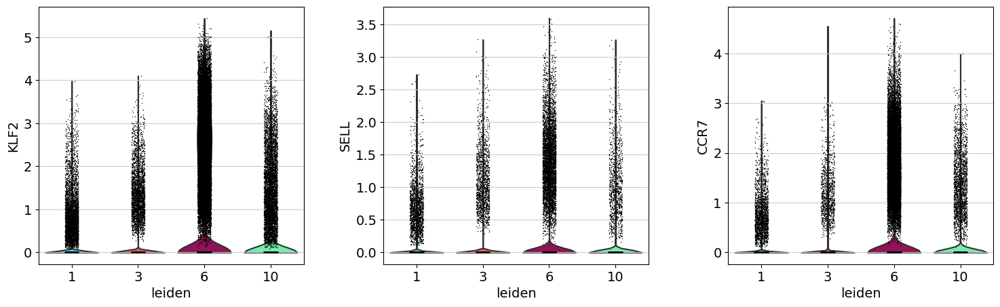

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


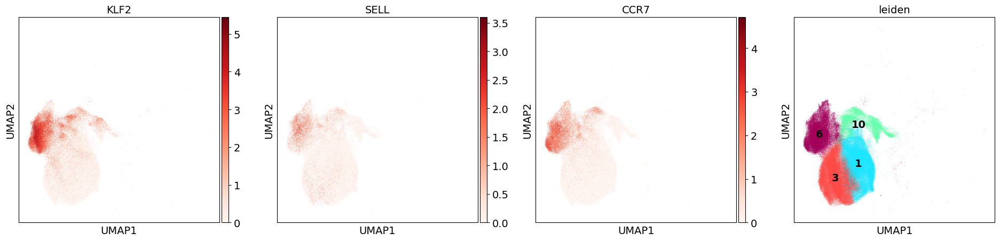

In [126]:
Glist=['KLF2','SELL','CCR7']
for i in Glist[:]:
    if i  in B.var_names:
        print(i+' is in B.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in B.var_names')
sc.pl.violin(B, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(B, color=Glist,legend_loc='on data')

#### cycling B

PCLAF is in B.var_names
BIRC5 is in B.var_names
TOP2A is in B.var_names
STMN1 is in B.var_names


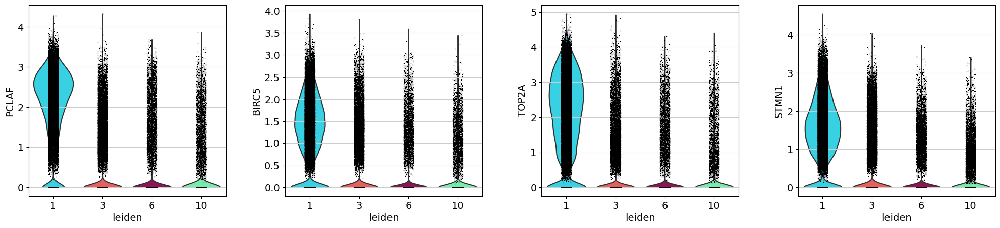

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


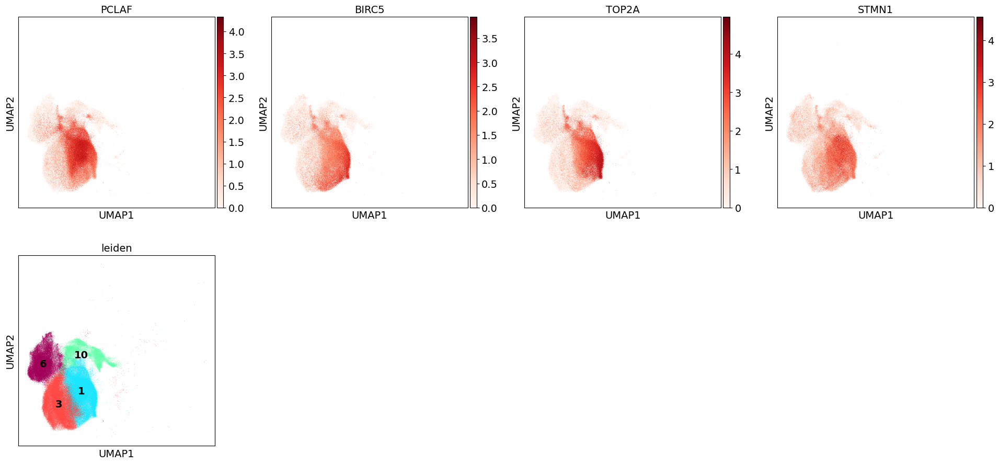

In [127]:
Glist=['PCLAF','BIRC5','TOP2A','STMN1']
for i in Glist[:]:
    if i  in B.var_names:
        print(i+' is in B.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in B.var_names')
sc.pl.violin(B, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(B, color=Glist,legend_loc='on data')

#### activated B

AICDA is in B.var_names
BCL6 is in B.var_names
CD86 is in B.var_names
CD79B is in B.var_names
MS4A1 is not in B.var_names


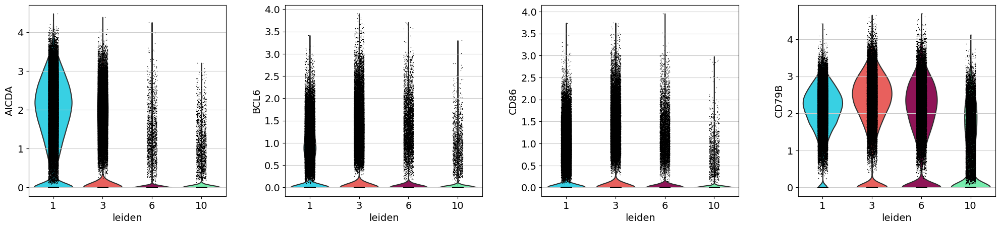

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


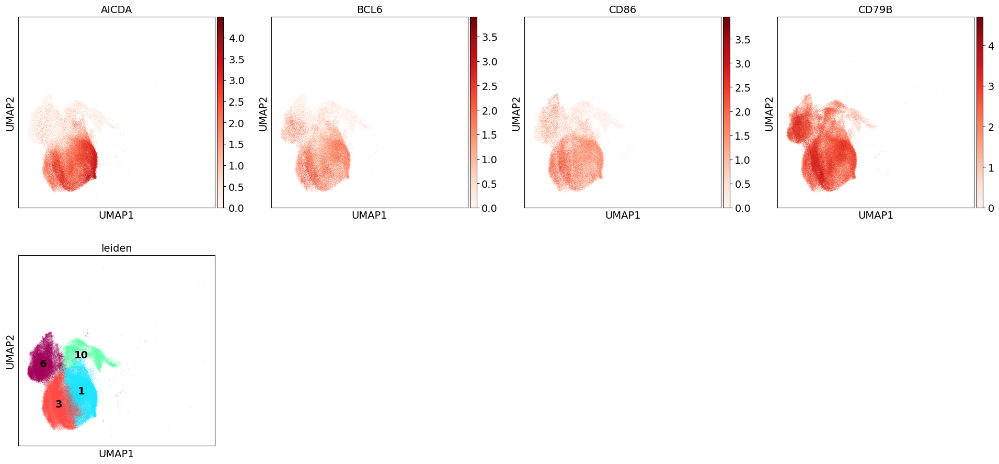

In [130]:
Glist=['AICDA', 'BCL6','CD86','CD79B','MS4A1']
for i in Glist[:]:
    if i  in B.var_names:
        print(i+' is in B.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in B.var_names')
sc.pl.violin(B, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(B, color=Glist,legend_loc='on data')

#### rank gene

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


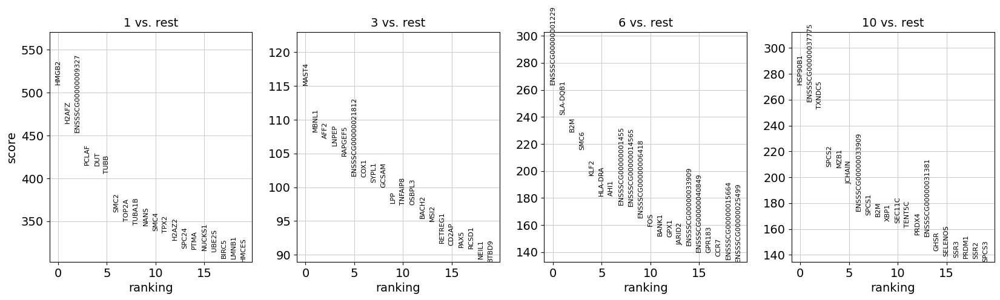

In [129]:
sc.tl.rank_genes_groups(B, 'leiden',n_genes=20)
sc.pl.rank_genes_groups(B, n_genes=20, sharey=False)

#### annotation

In [131]:
def function(a):
    if a in ['10']:
        return "Plasma cells"
    elif a in ['3']:
        return "Activated B cells"
    elif a in ['1']:
        return "Cycling B cells"
    elif a in ['6']:
        return "Resting B cells"
df = B.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
B.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


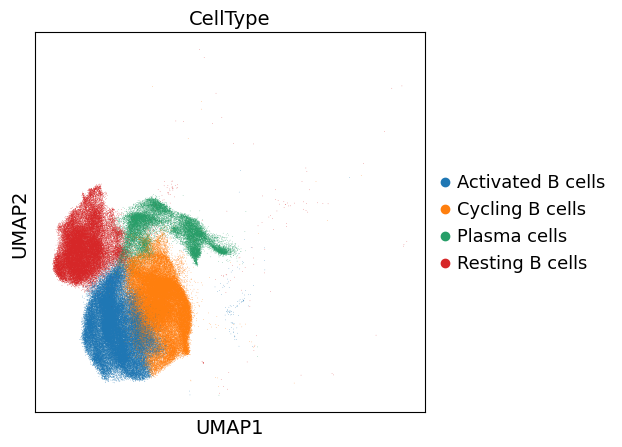

In [132]:
sc.pl.umap(B, color=["CellType"])

In [133]:
B.write('./B.h5ad')

#### ingest to adata

In [276]:
adata.obs['CellType'] = adata.obs['CellType'].astype(str)
adata_celltypes = np.unique(adata.obs['CellType'])
B_celltypes = np.unique(B.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(B_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [279]:
adata.obs.loc[B.obs_names,'CellType'] = B.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


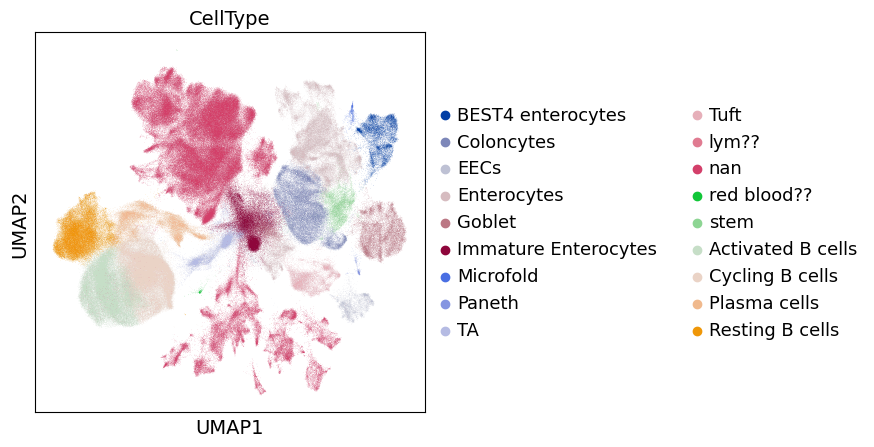

In [280]:
sc.pl.umap(adata,color='CellType')

### endo

In [165]:
endo=adata[adata.obs['Lineage']=='Endothelial lineage']

In [166]:
endo

View of AnnData object with n_obs × n_vars = 6484 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### re-cluster

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


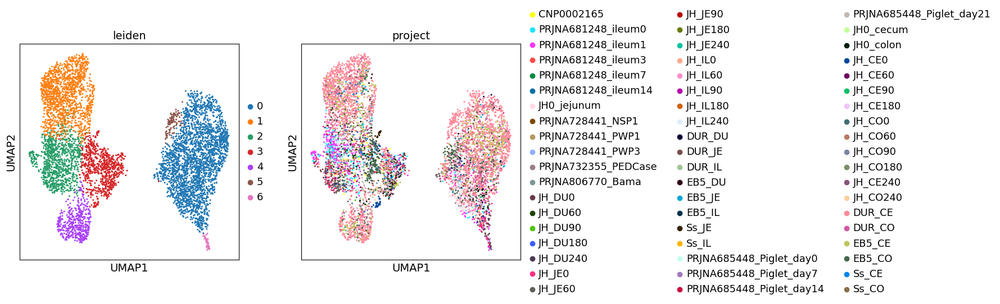

In [174]:
sc.pp.neighbors(endo, use_rep = 'X_scVI')
sc.tl.umap(endo)
sc.tl.leiden(endo, resolution = 0.3)
sc.pl.umap(endo, color=['leiden','project'])

#### arterial

GJA4 is in endo.var_names
HEY1 is in endo.var_names
HEY2 is in endo.var_names
EFNB2 is in endo.var_names


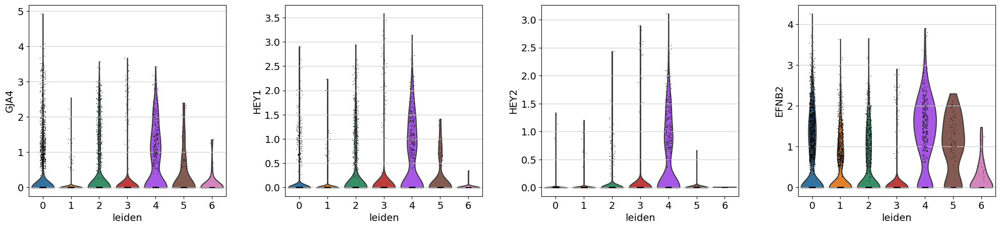

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


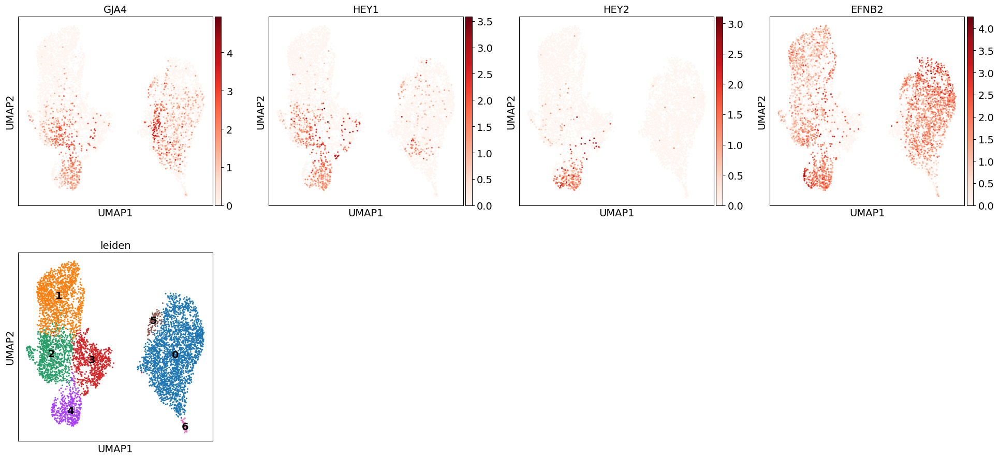

In [169]:
Glist=['GJA4', 'HEY1', 'HEY2', 'EFNB2']
for i in Glist[:]:
    if i  in endo.var_names:
        print(i+' is in endo.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in endo.var_names')
sc.pl.violin(endo, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(endo, color=Glist,legend_loc='on data')

#### venous

ACKR1 is in endo.var_names


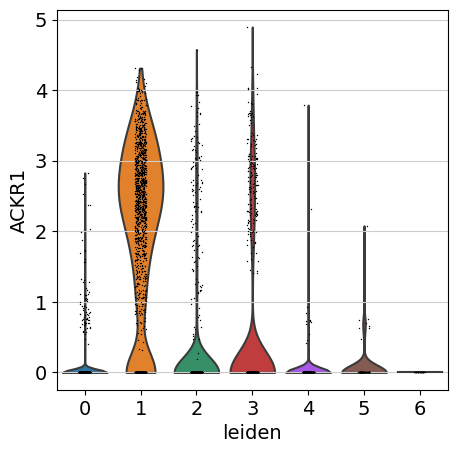

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


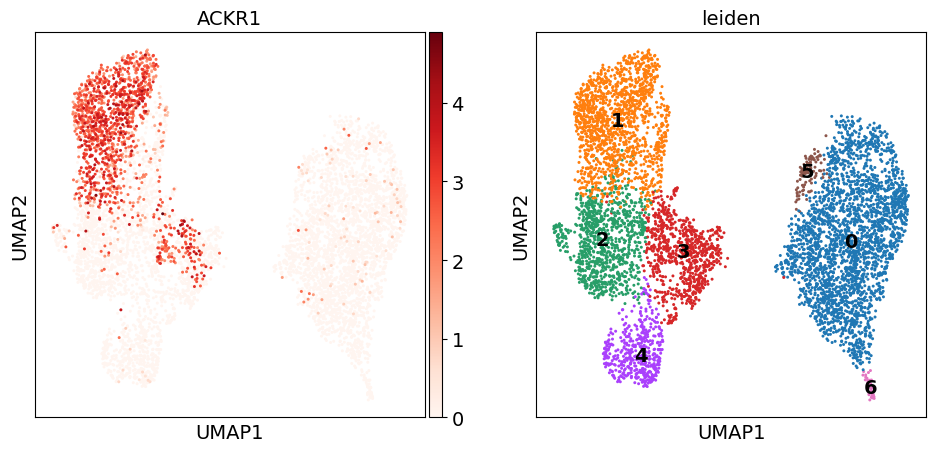

In [172]:
Glist=['ACKR1']
for i in Glist[:]:
    if i  in endo.var_names:
        print(i+' is in endo.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in endo.var_names')
sc.pl.violin(endo, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(endo, color=Glist,legend_loc='on data')

#### lymphatic endothelium

PROX1 is in endo.var_names
LYVE1 is in endo.var_names
CCL21 is in endo.var_names


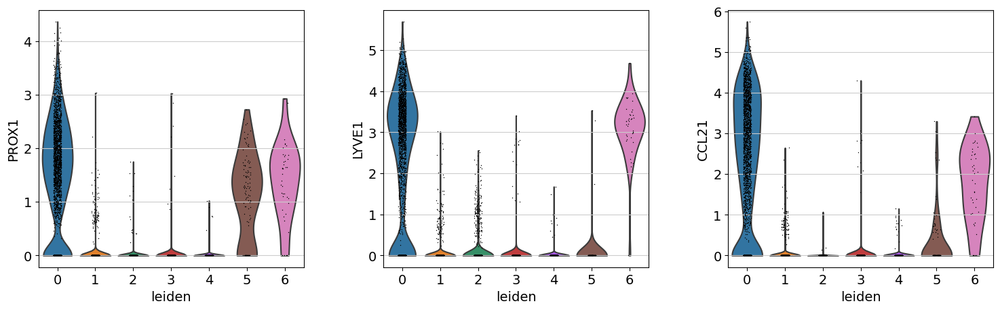

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


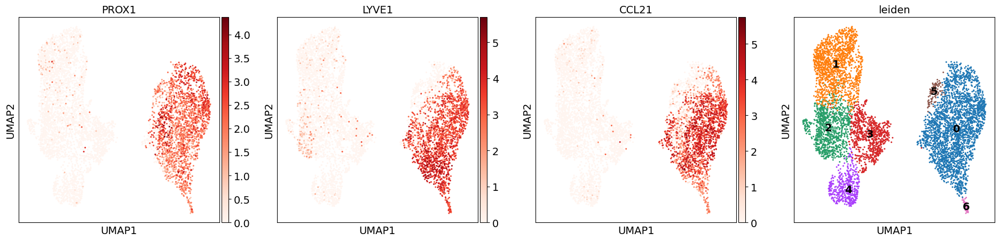

In [171]:
Glist=['PROX1', 'LYVE1', 'CCL21']
for i in Glist[:]:
    if i  in endo.var_names:
        print(i+' is in endo.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in endo.var_names')
sc.pl.violin(endo, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(endo, color=Glist,legend_loc='on data')

#### rank gene

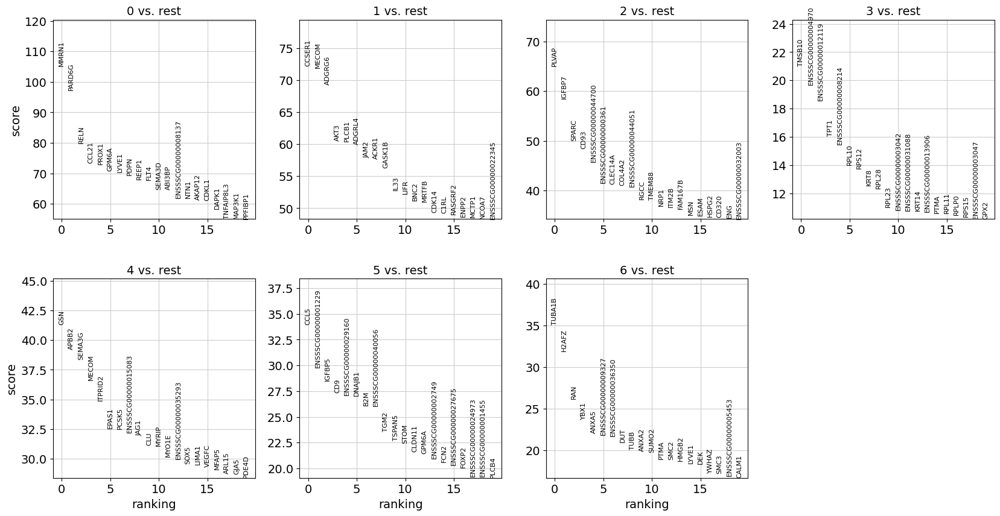

In [175]:
sc.tl.rank_genes_groups(endo, 'leiden',n_genes=20)
sc.pl.rank_genes_groups(endo, n_genes=20, sharey=False)

#### annotation

In [176]:
def function(a):
    if a in ['2','4']:
        return "arterial"
    elif a in ['1','3']:
        return "Venous"
    elif a in ['0','5','6']:
        return "Lymphatic endothelium"
df = endo.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
endo.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


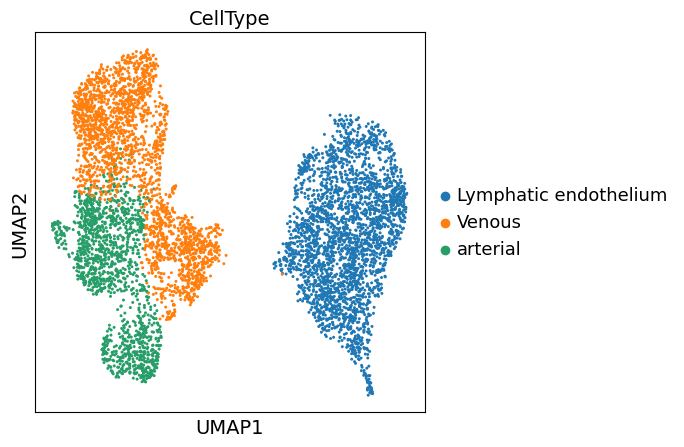

In [177]:
sc.pl.umap(endo, color=["CellType"])

In [179]:
adata.obs['Lineage']

AAACCCAAGAGTTGAT-1_CNP0002165                    B lineage
AAACCCAAGCAACTTC-1_CNP0002165                    B lineage
AAACCCAAGCAGTCTT-1_CNP0002165           Epithelial lineage
AAACCCAAGCGCATCC-1_CNP0002165                    B lineage
AAACCCAAGGGTAGCT-1_CNP0002165                    B lineage
                                               ...        
TTTGTTGCAATCGCCG-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTACCTAGT-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTACTAAGA-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTTTCGCTC-1_PRJNA859792_NoPP4    Epithelial lineage
TTTGTTGTCAGTGTCA-1_PRJNA859792_NoPP4         T/ILC lineage
Name: Lineage, Length: 589101, dtype: category
Categories (7, object): ['B lineage', 'Endothelial lineage', 'Epithelial lineage', 'Mesenchymal lineage', 'Myeloid lineage', 'T/ILC lineage', 'Neuron Lineage']

In [237]:
endo.write('./endo.h5ad')

#### ingest to adata

In [281]:
adata.obs['CellType'] = adata.obs['CellType'].astype(str)
adata_celltypes = np.unique(adata.obs['CellType'])
endo_celltypes = np.unique(endo.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(endo_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [282]:
adata.obs.loc[endo.obs_names,'CellType'] = endo.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


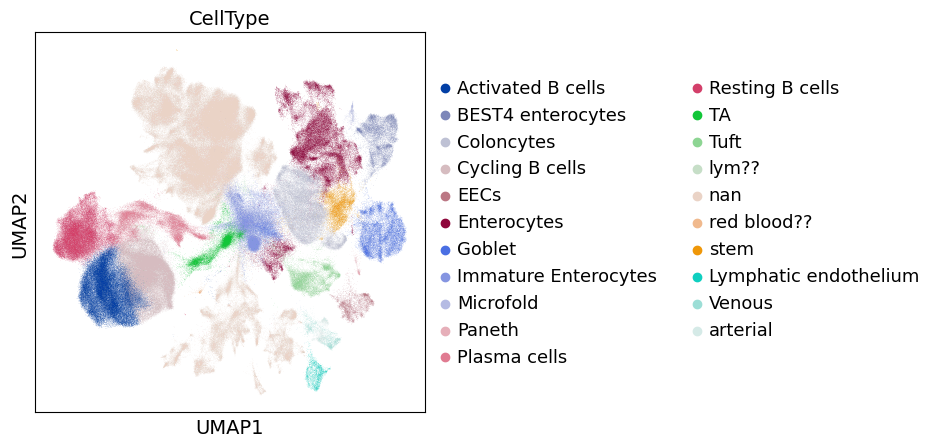

In [283]:
sc.pl.umap(adata,color='CellType')

### Myeloid lineage

In [180]:
mye=adata[adata.obs['Lineage']=='Myeloid lineage']

In [181]:
mye

View of AnnData object with n_obs × n_vars = 28936 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### re-cluster

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


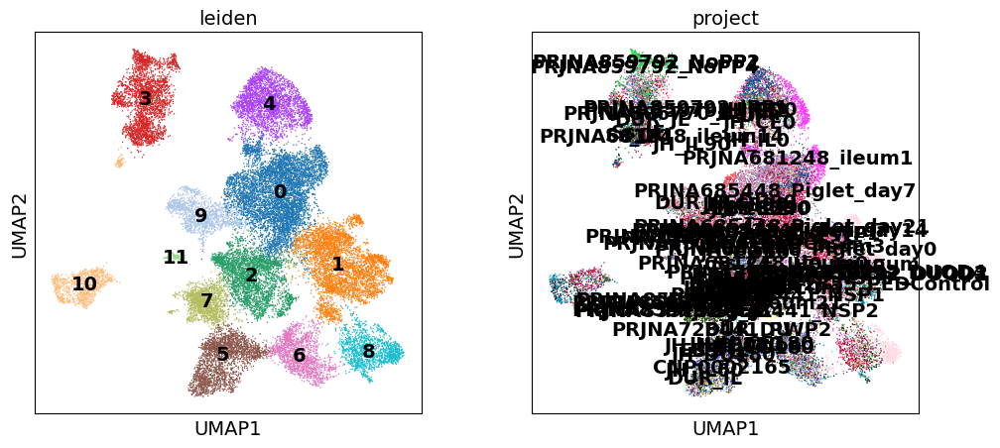

In [208]:
sc.pp.neighbors(mye, use_rep = 'X_scVI')
sc.tl.umap(mye)
sc.tl.leiden(mye, resolution = 0.4)
sc.pl.umap(mye, color=['leiden','project'],legend_loc='on data')

#### macrophage

In [ ]:
# macrophage=['APOE','CST3','C1QA','C1QC']
# macrophage2=['CD68','C1QA','C1QB']#巨噬细胞 

CD68 is in mye.var_names
APOE is in mye.var_names
C1QA is in mye.var_names
C1QB is in mye.var_names
C1QC is in mye.var_names


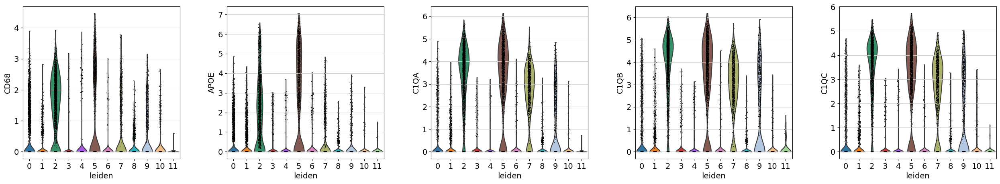

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


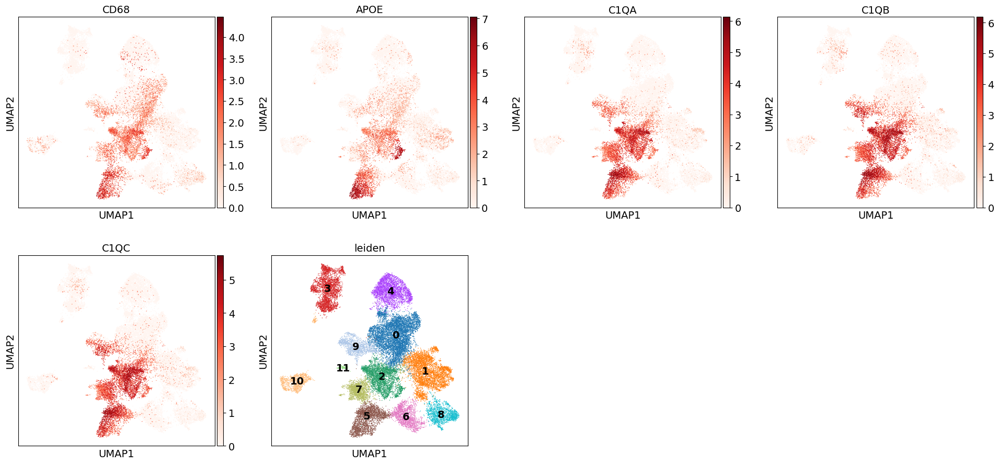

In [209]:
Glist=['CD68','APOE','C1QA','C1QB','C1QC']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### monocyte

CD14 is in mye.var_names
S100A4 is in mye.var_names
S100A6 is in mye.var_names


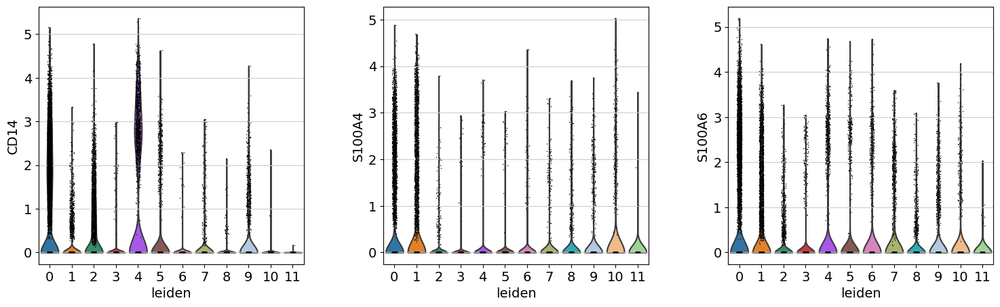

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


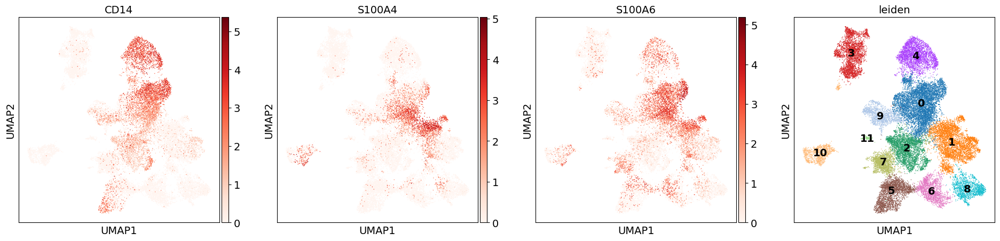

In [210]:
Glist=['CD14','S100A4', 'S100A6']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

CEBPB is in mye.var_names
S100A12 is in mye.var_names
ENSSSCG00000029414 is in mye.var_names


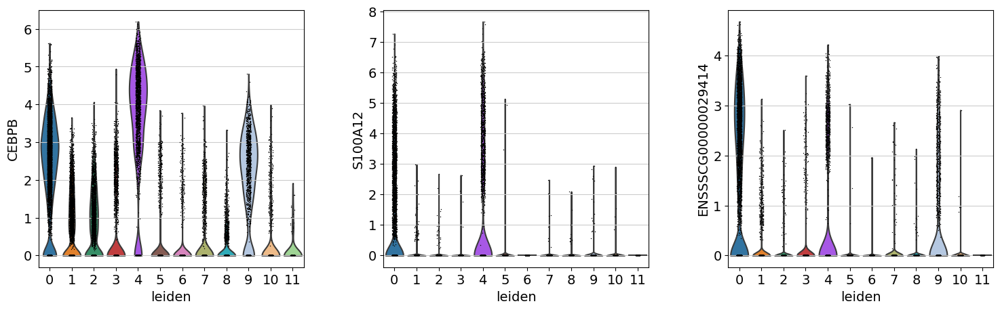

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


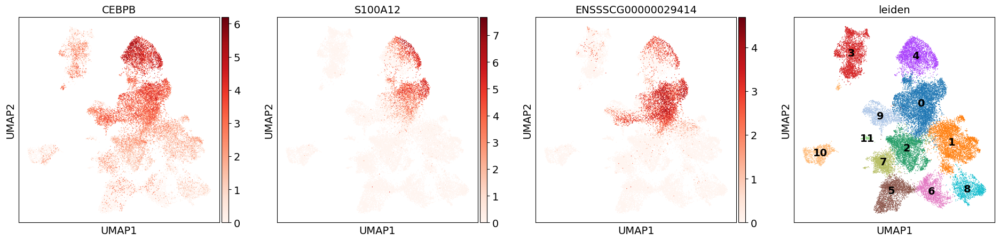

In [211]:
Glist=['CEBPB','S100A12','ENSSSCG00000029414']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### Dendritic

LTA4H is in mye.var_names
RETN is in mye.var_names
CEBPE is in mye.var_names
GSN is in mye.var_names


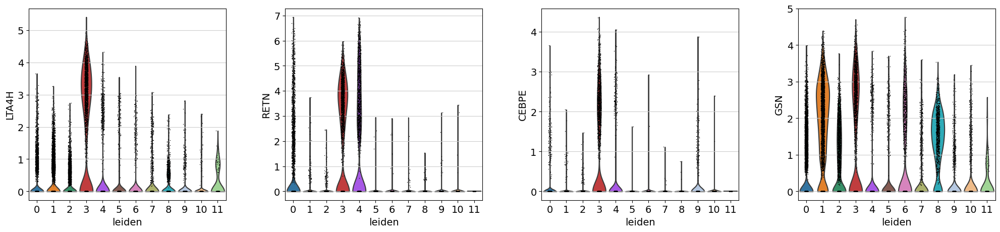

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


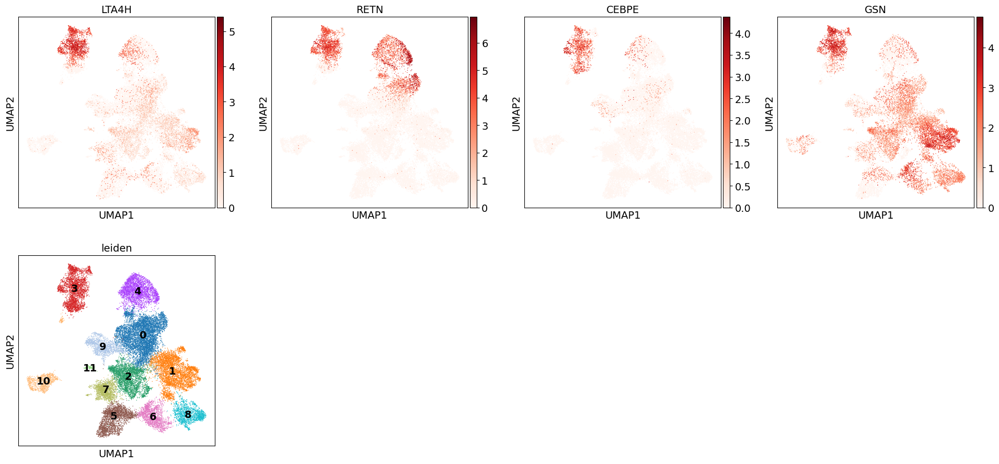

In [212]:
Glist=['LTA4H','RETN','CEBPE','GSN']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

HLA-DRA is in mye.var_names
SLA-DQB1 is in mye.var_names
FCER1A is in mye.var_names
CD1E is in mye.var_names


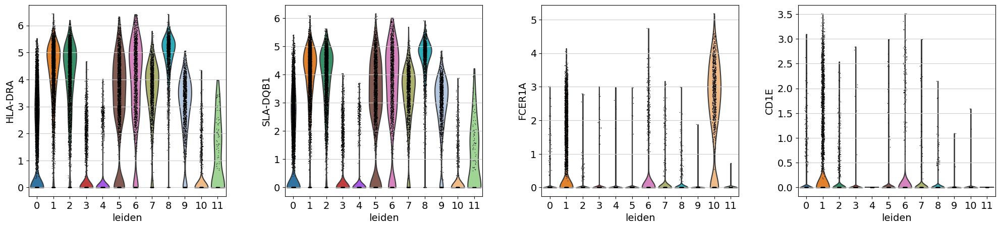

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


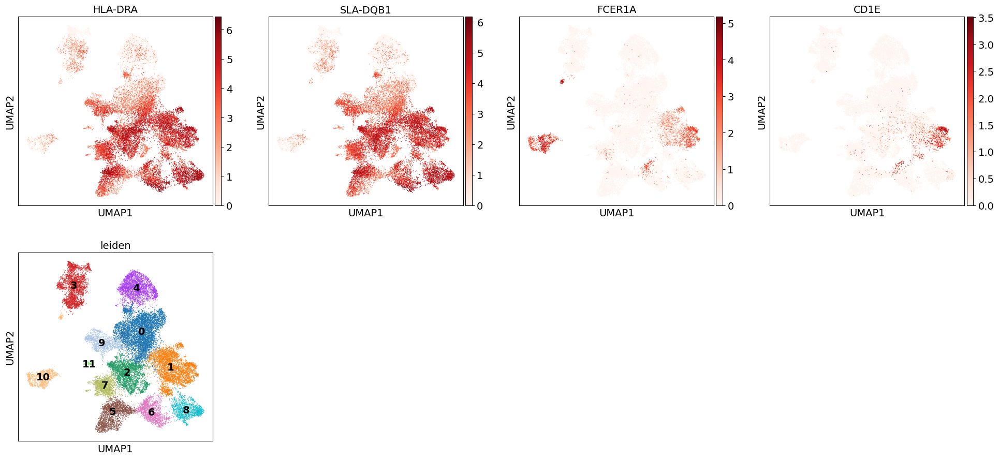

In [213]:
Glist=['HLA-DRA','SLA-DQB1','FCER1A','CD1E']#DENDRITIC2
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

XCR1 is in mye.var_names
SNX22 is in mye.var_names


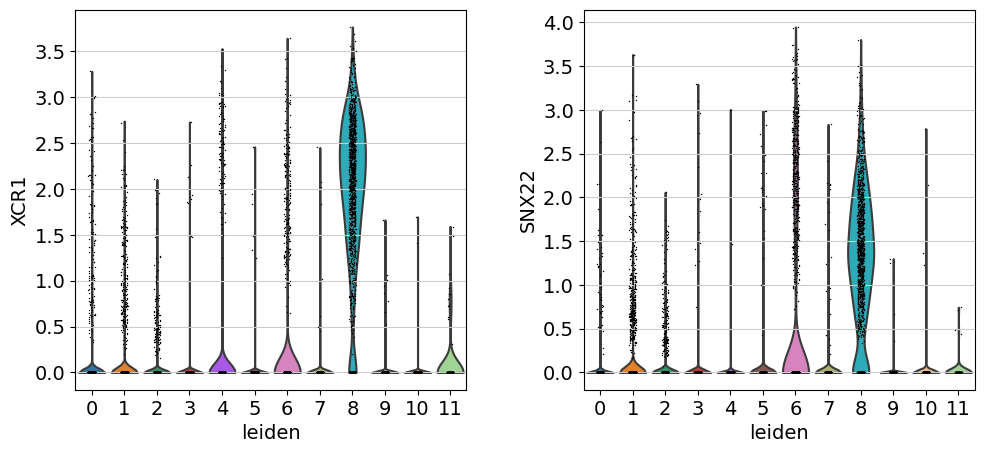

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


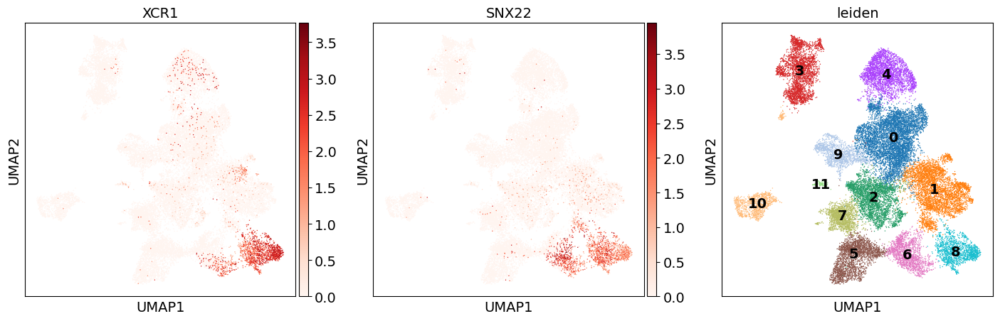

In [214]:
Glist=['XCR1','SNX22']#DENDRITIC3
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### Mast

MCT7 is not in mye.var_names
LTC4S is in mye.var_names
CCN3 is in mye.var_names
LMNA is in mye.var_names
MS4A2 is in mye.var_names


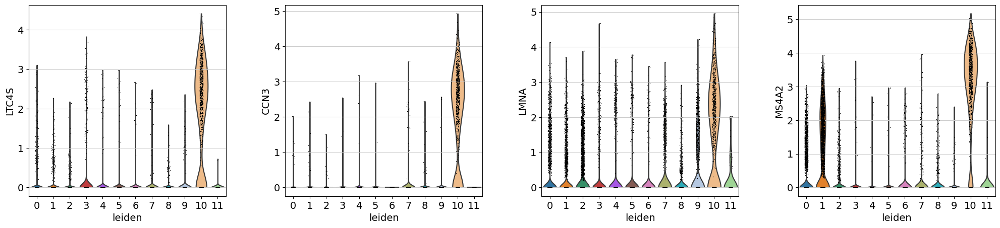

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


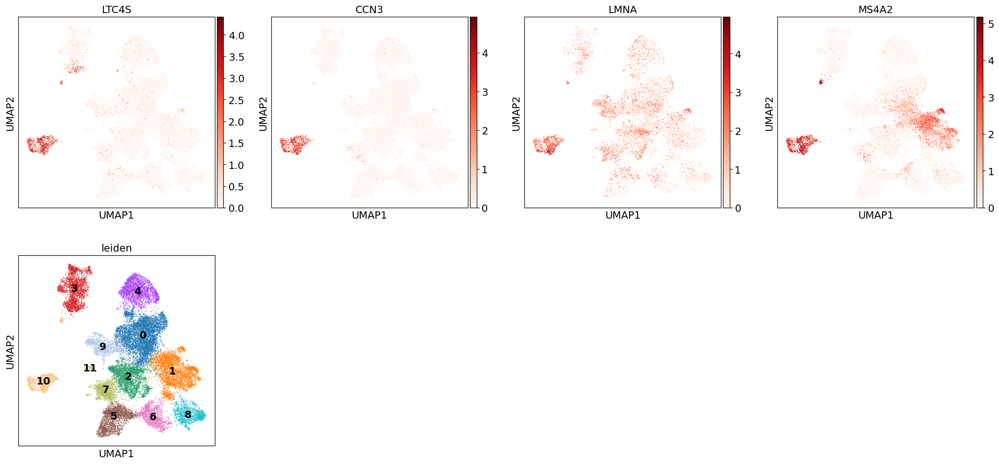

In [215]:
Glist=['MCT7','LTC4S','CCN3','LMNA','MS4A2']#MAST
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### plasmacytoid DCs

ENSSSCG00000010077 is in mye.var_names
VPREB1 is in mye.var_names
JCHAIN is in mye.var_names
IRF7 is in mye.var_names
MZB1 is in mye.var_names


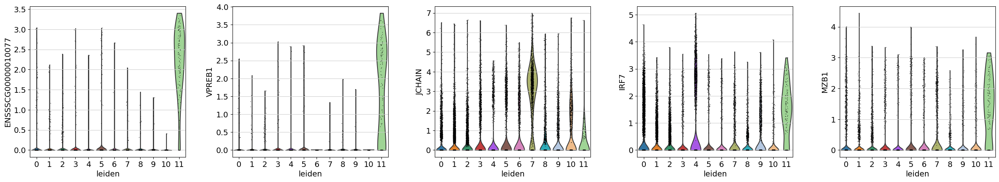

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


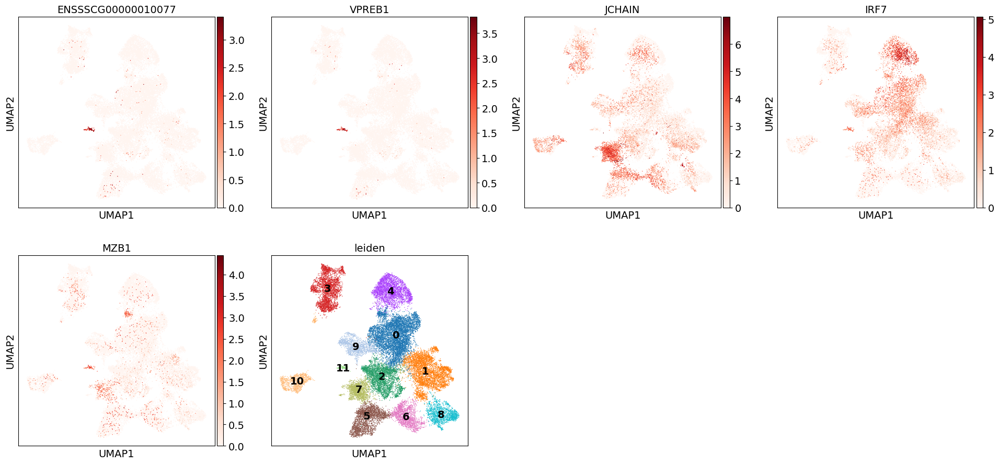

In [218]:
Glist=['ENSSSCG00000010077','VPREB1', 'JCHAIN','IRF7','MZB1']#plasmacytoid DCs
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### annotation

In [232]:
def function(a):
    if a in ['2','5','7','9']:
        return "Macrophage"
    elif a in ['0','4']:
        return "Monocyte"
    elif a in ['3','6','8']:
        return "Dendritic"
    elif a in ['10']:
        return "Mast"
    elif a in ['11']:
        return "Plasmacytoid DCs"
    elif a in ['1']:
        return "mass"
df = mye.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mye.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


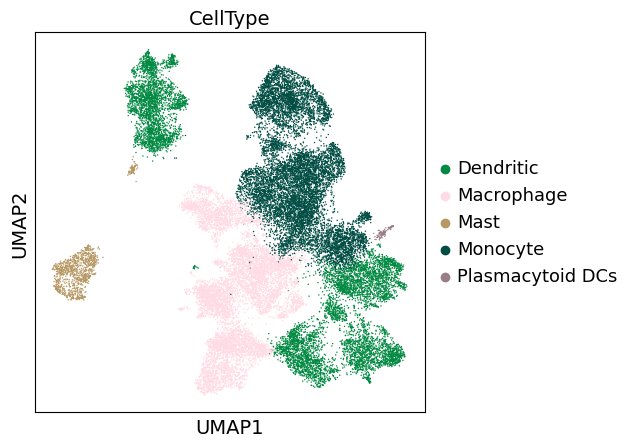

In [527]:
sc.pl.umap(mye, color=["CellType"])

#### mass

##### mass_mono

In [521]:
mass=mye[mye.obs['CellType']=='mass']

In [523]:
mass

View of AnnData object with n_obs × n_vars = 0 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType', 'lym'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'lym_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

In [ ]:
sc.tl.leiden(mass,resolution = 0.3)
sc.pl.umap(mass,color='leiden')

In [ ]:
Glist=['S100A4', 'S100A6']#monocyte
for i in Glist[:]:
    if i  in mass.var_names:
        print(i+' is in mass.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mass.var_names')
sc.pl.violin(mass, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mass, color=Glist,legend_loc='on data')

##### mass_dentritic

FCER1A is in mass.var_names
CD1E is in mass.var_names


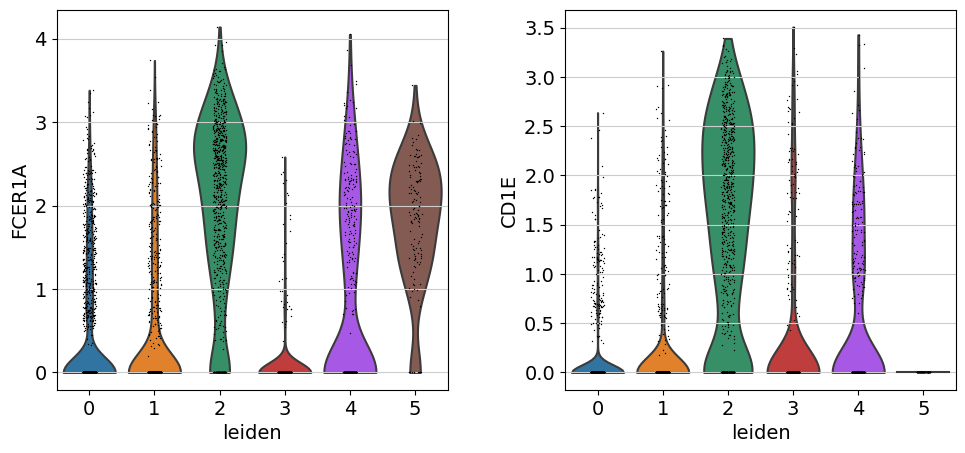

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


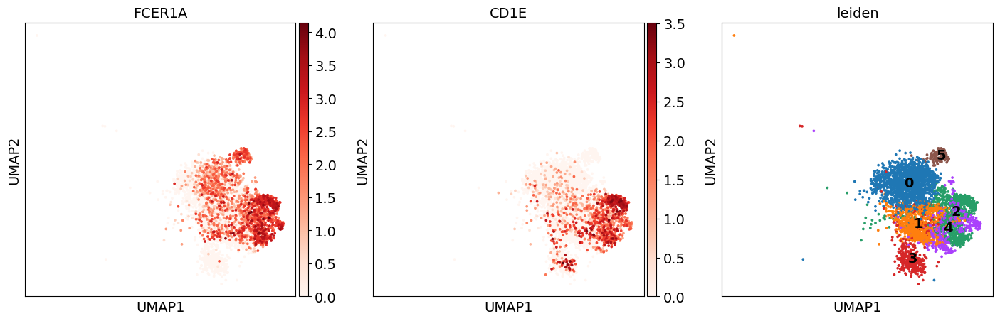

In [230]:
Glist=['FCER1A','CD1E']#dentritic
for i in Glist[:]:
    if i  in mass.var_names:
        print(i+' is in mass.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mass.var_names')
sc.pl.violin(mass, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mass, color=Glist,legend_loc='on data')

##### mass_annotation

In [231]:
def function(a):
    if a in ['1','2','3','4']:
        return "Dendritic"
    elif a in ['0','5']:
        return "Monocyte"
df = mass.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mass.obs=df 
#跨列操作，与axis=0对应

In [526]:
mye.obs.loc[mass.obs_names,'CellType'] = mass.obs['CellType'].astype('object')
mye.obs['CellType'] = mye.obs['CellType'].cat.remove_unused_categories()

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


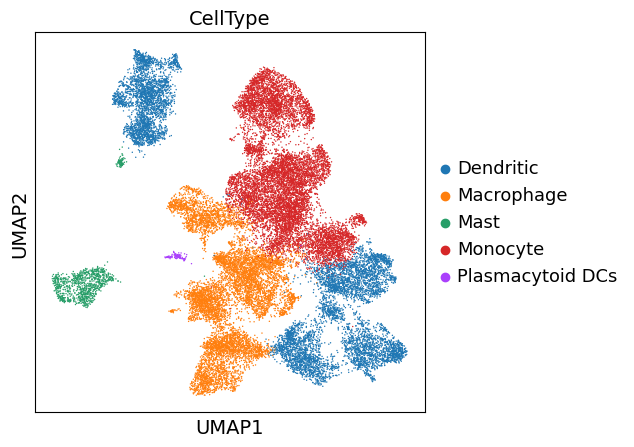

In [235]:
sc.pl.umap(mye, color=["CellType"])

In [236]:
mye.write('./mye.h5ad')

#### ingest to adata

In [528]:
adata.obs['CellType'] = adata.obs['CellType'].astype(str)
adata_celltypes = np.unique(adata.obs['CellType'])
mye_celltypes = np.unique(mye.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(mye_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [529]:
adata.obs.loc[mye.obs_names,'CellType'] = mye.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


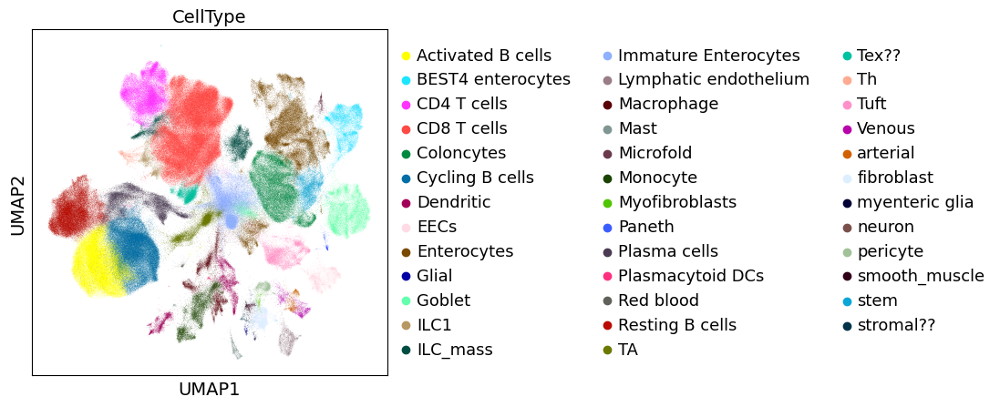

In [530]:
sc.pl.umap(adata,color='CellType')

### Neuron

In [291]:
neu=adata[adata.obs['Lineage']=='Neuron Lineage']

In [ ]:
神经元：GAP43，ELAVL4
神经胶质：CLDN11，GFAP

In [292]:
neu

View of AnnData object with n_obs × n_vars = 2259 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### re-cluster

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


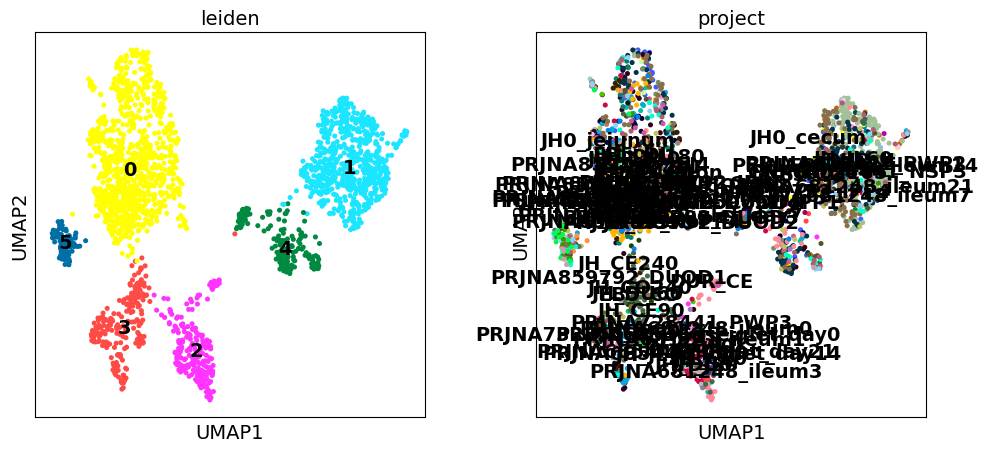

In [294]:
sc.pp.neighbors(neu, use_rep = 'X_scVI')
sc.tl.umap(neu)
sc.tl.leiden(neu, resolution = 0.2)
sc.pl.umap(neu, color=['leiden','project'],legend_loc='on data')

#### neuronal 

GAP43 is in neu.var_names
ELAVL4 is in neu.var_names


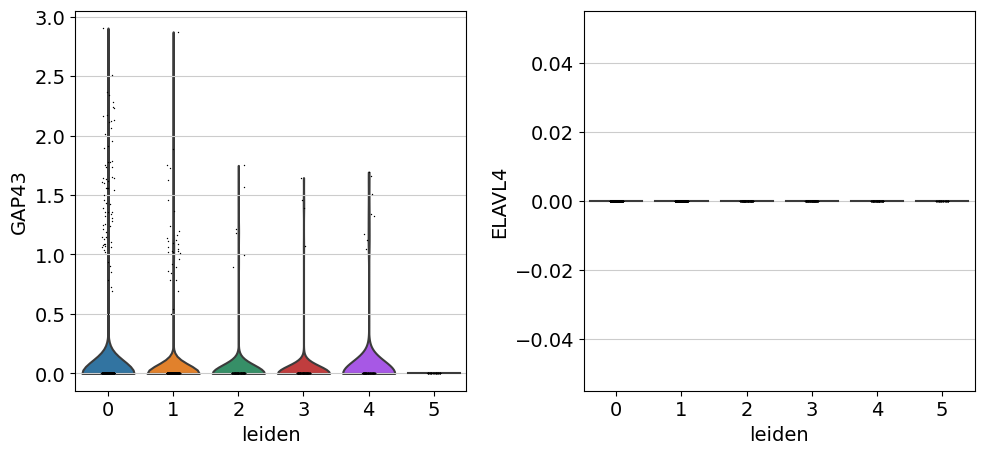

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


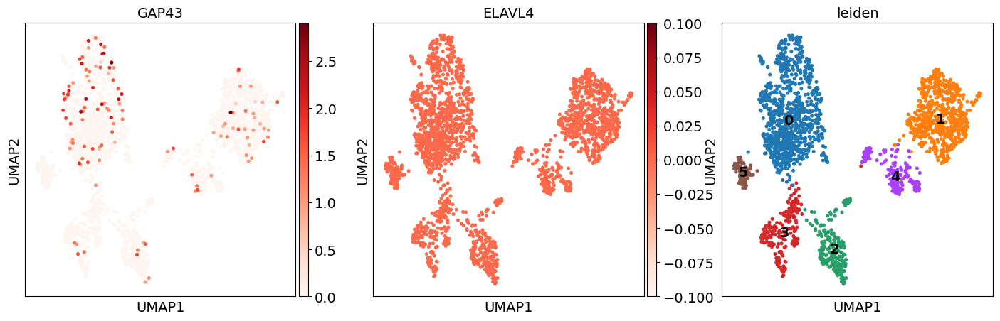

In [295]:
Glist=['GAP43', 'ELAVL4']
for i in Glist[:]:
    if i  in neu.var_names:
        print(i+' is in neu.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in neu.var_names')
sc.pl.violin(neu, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(neu, color=Glist,legend_loc='on data')

#### glial

GFAP is in neu.var_names


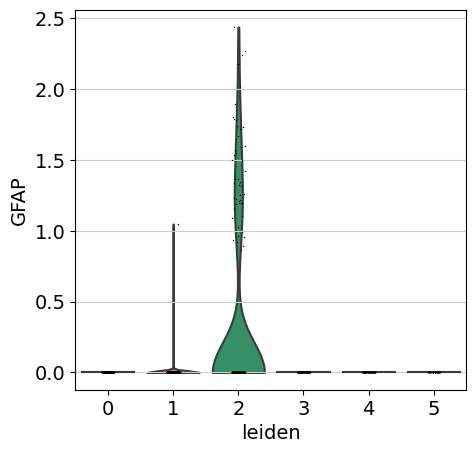

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


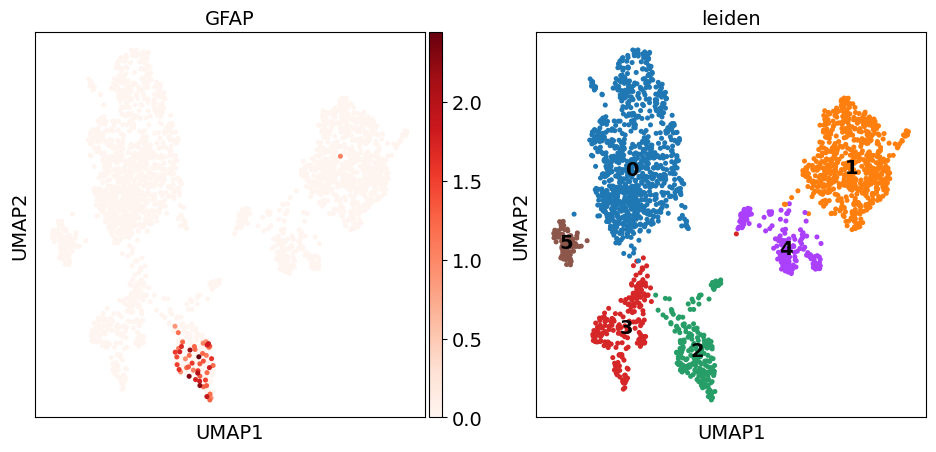

In [310]:
Glist=['GFAP']
for i in Glist[:]:
    if i  in neu.var_names:
        print(i+' is in neu.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in neu.var_names')
sc.pl.violin(neu, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(neu, color=Glist,legend_loc='on data')

#### annotation

In [302]:
def function(a):
    if a in ['0','1','3','4','5']:
        return "neuron"
    elif a in ['2']:
        return "Glial"
df = neu.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
neu.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


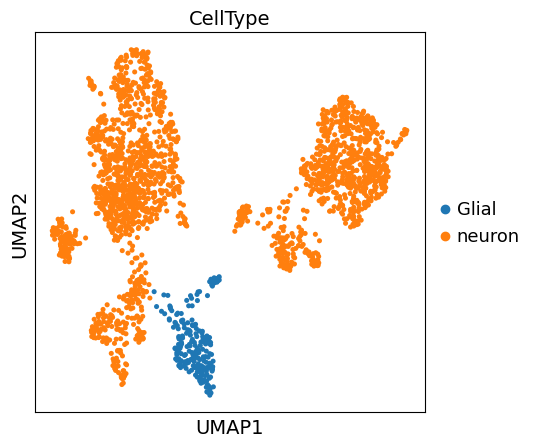

In [346]:
sc.pl.umap(neu, color=["CellType"])

#### ingest to adata

In [303]:
adata.obs['CellType'] = adata.obs['CellType'].astype(str)
adata_celltypes = np.unique(adata.obs['CellType'])
neu_celltypes = np.unique(neu.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(neu_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [304]:
adata.obs.loc[neu.obs_names,'CellType'] = neu.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


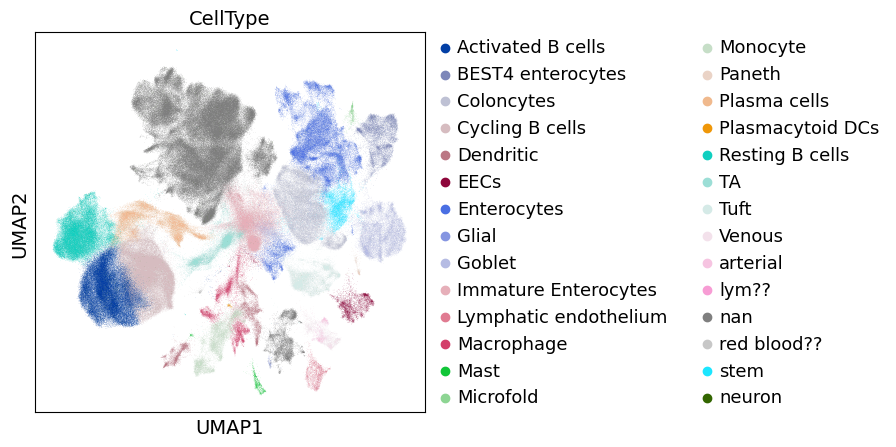

In [305]:
sc.pl.umap(adata,color='CellType')

### Mesenchymal

In [308]:
mes=adata[adata.obs['Lineage']=='Mesenchymal lineage']

In [309]:
mes

View of AnnData object with n_obs × n_vars = 9158 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### re-cluster

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


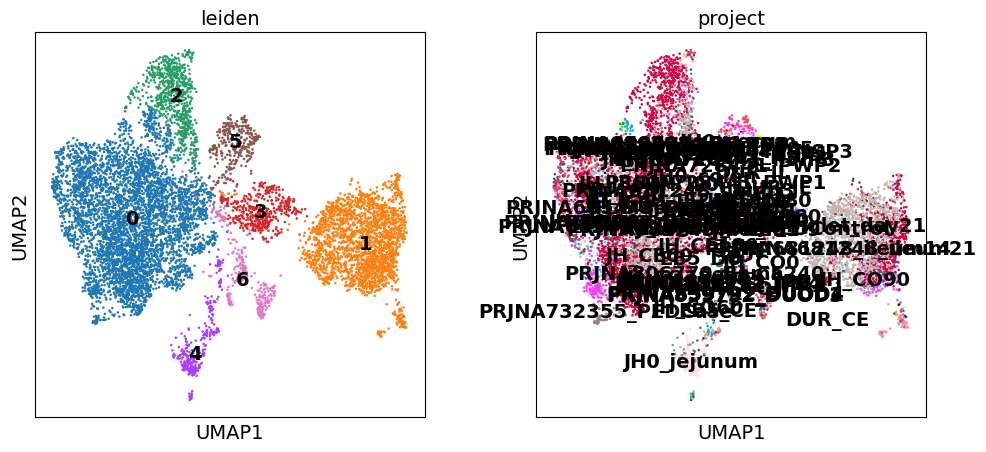

In [312]:
sc.pp.neighbors(mes, use_rep = 'X_scVI')
sc.tl.umap(mes)
sc.tl.leiden(mes, resolution = 0.2)
sc.pl.umap(mes, color=['leiden','project'],legend_loc='on data')

#### smooth_muscle

MYOCD is in mes.var_names
DES is in mes.var_names
CNN1 is in mes.var_names
ACTA2 is in mes.var_names
MYH11 is in mes.var_names


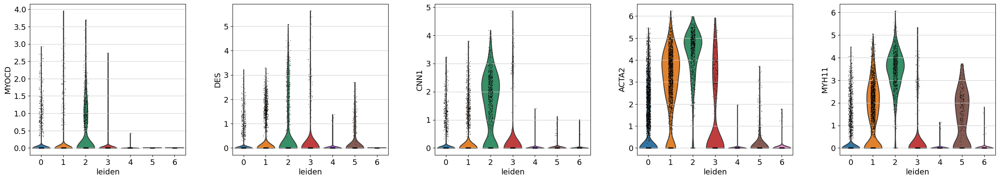

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


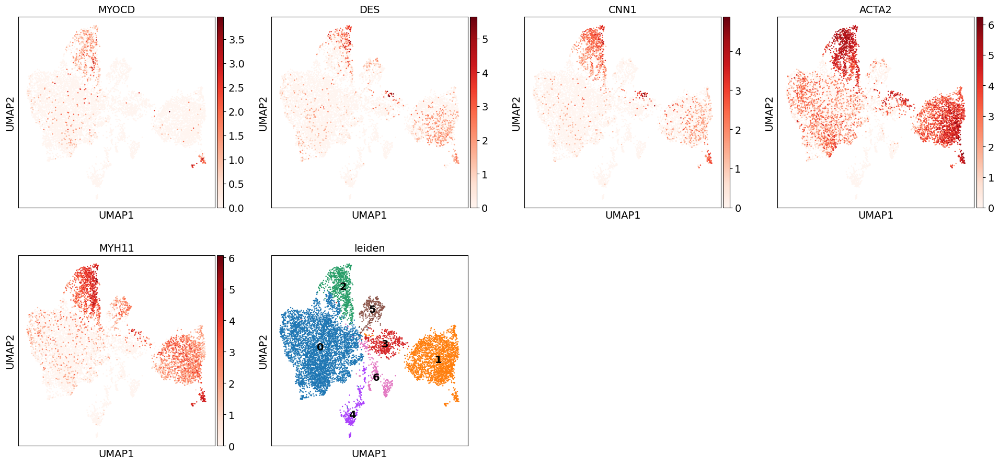

In [341]:
Glist=['MYOCD','DES','CNN1','ACTA2', 'MYH11']
for i in Glist[:]:
    if i  in mes.var_names:
        print(i+' is in mes.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mes.var_names')
sc.pl.violin(mes, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mes, color=Glist,legend_loc='on data')

#### fibroblast

DCN is in mes.var_names
FRZB is in mes.var_names
BMP5 is in mes.var_names
C7 is in mes.var_names
ASPN is in mes.var_names


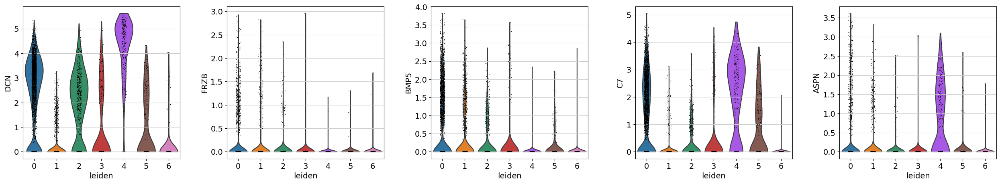

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


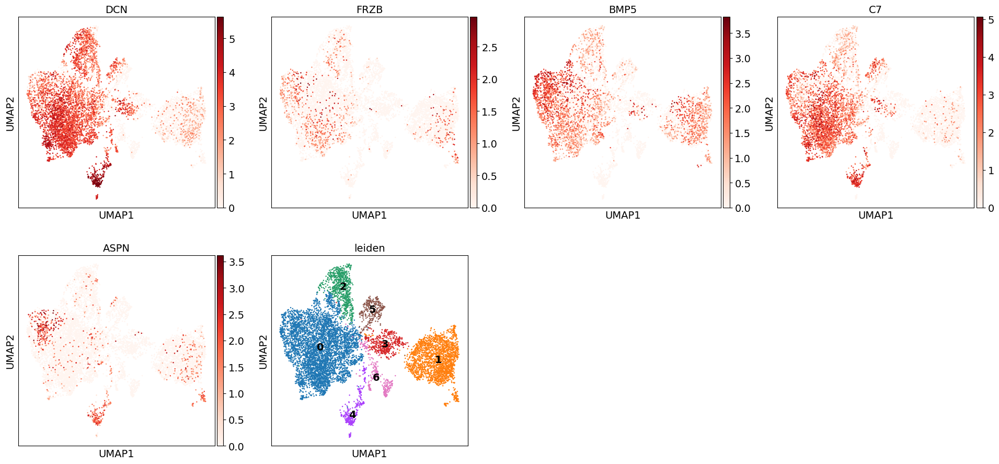

In [335]:
Glist=['DCN','FRZB','BMP5','C7','ASPN']
for i in Glist[:]:
    if i  in mes.var_names:
        print(i+' is in mes.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mes.var_names')
sc.pl.violin(mes, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mes, color=Glist,legend_loc='on data')

#### Myofibroblasts

ACTA2 is in mes.var_names
TAGLN is in mes.var_names
MYH11 is in mes.var_names
TAGLN is in mes.var_names
NKX2-3 is in mes.var_names
ACTG2 is in mes.var_names


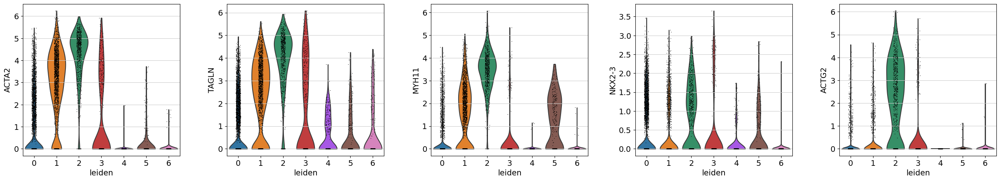

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


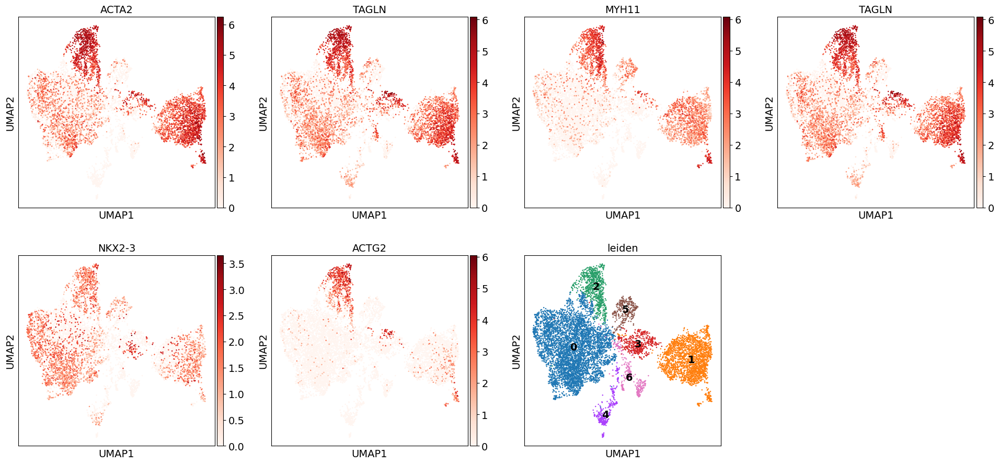

In [343]:
Glist=['ACTA2','TAGLN','MYH11','TAGLN','ACTG2']
for i in Glist[:]:
    if i  in mes.var_names:
        print(i+' is in mes.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mes.var_names')
sc.pl.violin(mes, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mes, color=Glist,legend_loc='on data')

#### pericyte

NOTCH3 is in mes.var_names
MCAM is in mes.var_names
CD146 is not in mes.var_names
RGS5 is in mes.var_names
KCNJ8 is in mes.var_names
ABCC9 is in mes.var_names
TGS5 is not in mes.var_names


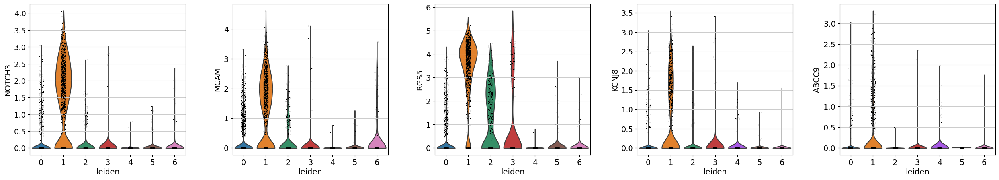

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


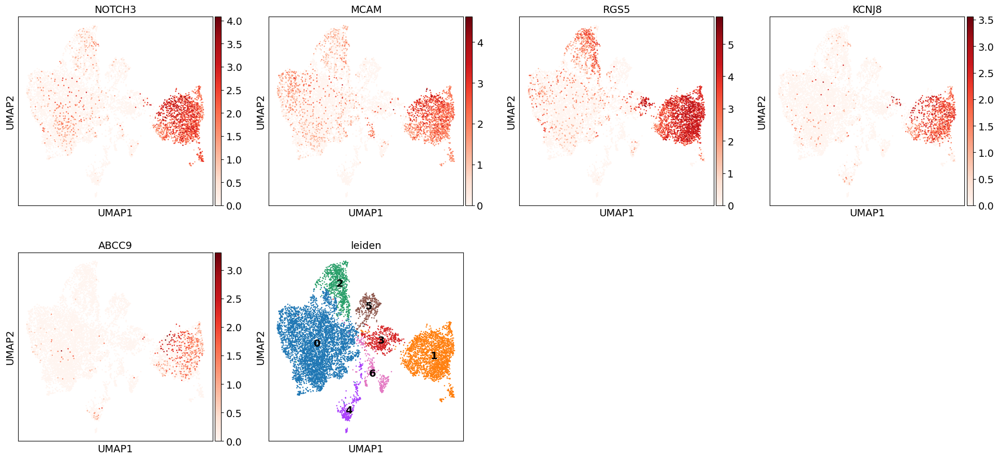

In [338]:
Glist=['NOTCH3', 'MCAM','CD146','RGS5','KCNJ8','ABCC9']
for i in Glist[:]:
    if i  in mes.var_names:
        print(i+' is in mes.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mes.var_names')
sc.pl.violin(mes, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mes, color=Glist,legend_loc='on data')

#### myenteric glia

https://journals.sagepub.com/doi/10.1177/17590914221083203?url_ver=Z39.88-2003&rfr_id=ori:rid:crossref.org&rfr_dat=cr_pub%20%200pubmed

GFAP is in mes.var_names
CD9 is in mes.var_names


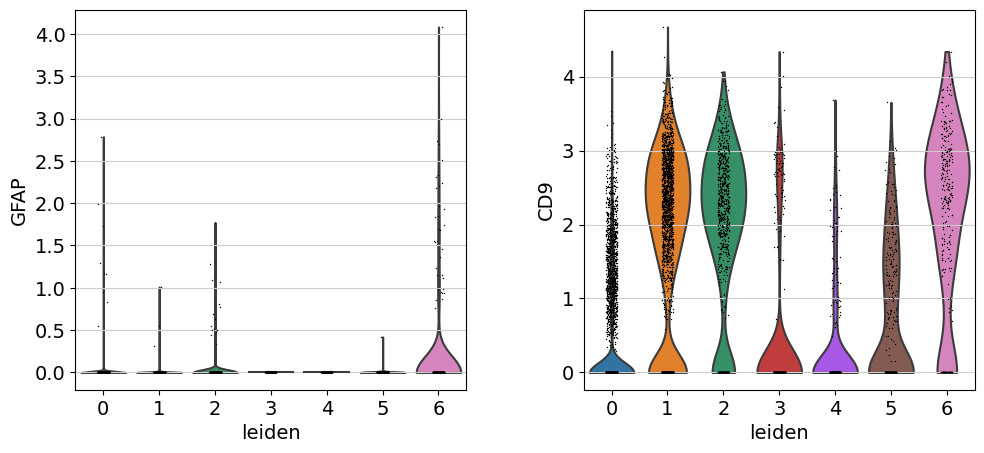

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


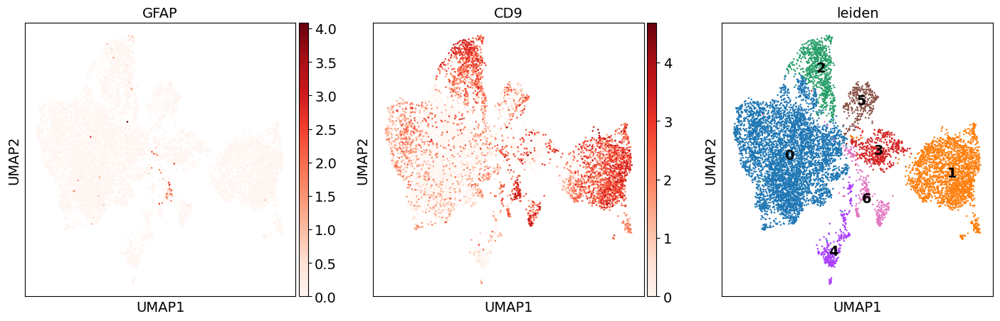

In [349]:
Glist=['GFAP','CD9']
for i in Glist[:]:
    if i  in mes.var_names:
        print(i+' is in mes.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mes.var_names')
sc.pl.violin(mes, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mes, color=Glist,legend_loc='on data')

#### rank gene

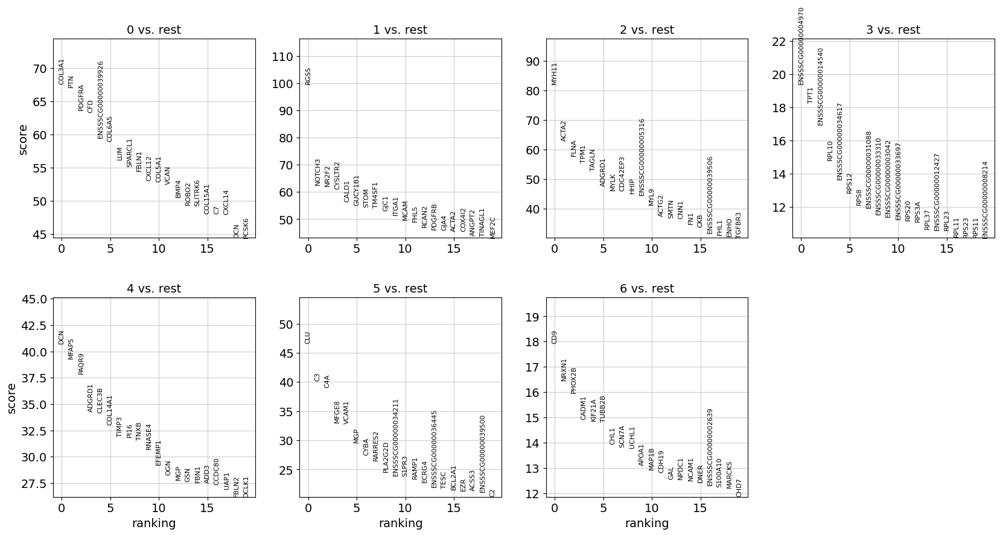

In [344]:
sc.tl.rank_genes_groups(mes, 'leiden',n_genes=20)
sc.pl.rank_genes_groups(mes, n_genes=20, sharey=False)

#### annotation

In [350]:
def function(a):
    if a in ['2']:
        return "smooth_muscle"
    elif a in ['3']:
        return "Myofibroblasts"
    elif a in ['0','4']:
        return "fibroblast"
    elif a in ['1']:
        return "pericyte"
    elif a in ['6']:
        return "myenteric glia"
    elif a in ['5']:
        return "C4A+ stromal"
df = mes.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mes.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


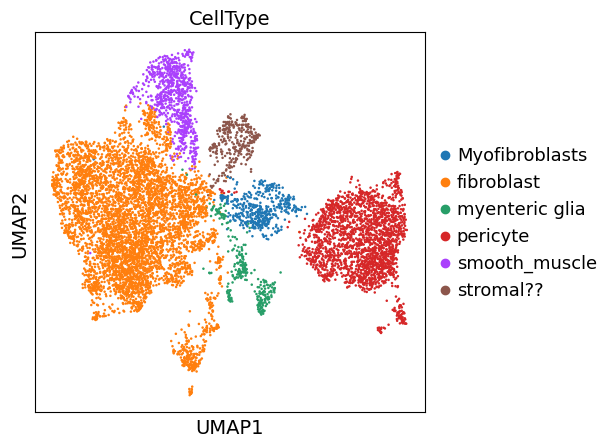

In [351]:
sc.pl.umap(mes, color=["CellType"])

#### ingest to adata

In [352]:
adata.obs['CellType'] = adata.obs['CellType'].astype(str)
adata_celltypes = np.unique(adata.obs['CellType'])
mes_celltypes = np.unique(mes.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(mes_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [353]:
adata.obs.loc[mes.obs_names,'CellType'] = mes.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


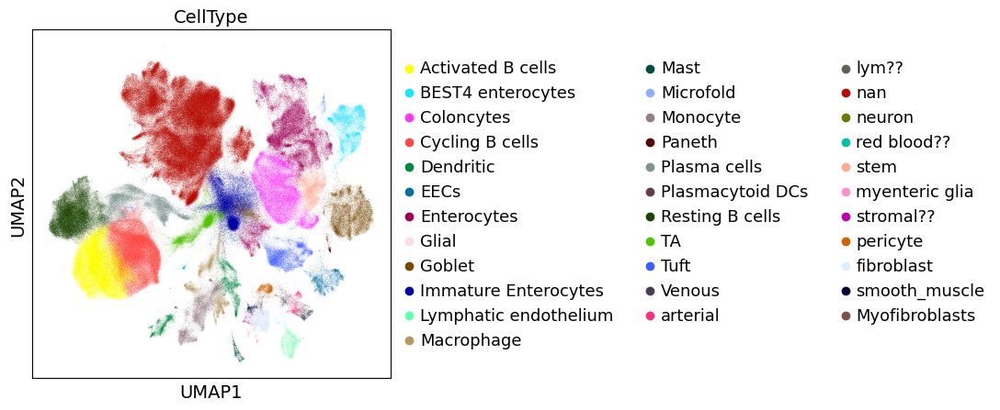

In [354]:
sc.pl.umap(adata,color='CellType')

## reorder and adjust

### red blood

In [512]:
adata.obs['CellType'] = adata.obs['CellType'].replace('red blood??', 'Red blood')
epi=adata[adata.obs['Lineage']=='Epithelial lineage']

In [451]:
red=adata[adata.obs['CellType']=='Red blood']

In [ ]:
adata.obs['Lineage']=adata.obs['Lineage'].cat.add_categories('Red blood')

In [453]:
adata.obs['Lineage'] = adata.obs['Lineage'].astype('category')
adata.obs.loc[red.obs_names,'Lineage'] = red.obs['CellType'].astype('object')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


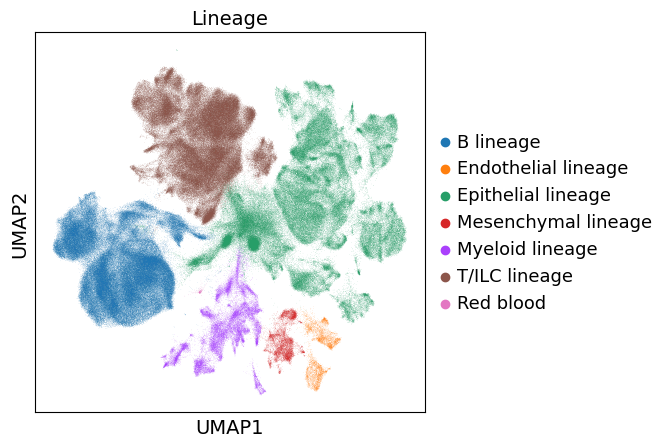

In [454]:
sc.pl.umap(adata,color='Lineage')

In [455]:
lym=adata[adata.obs['CellType']=='lym??']

In [456]:
lym

View of AnnData object with n_obs × n_vars = 20 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

In [462]:
adata.obs.loc[lym.obs_names,'lym'] = lym.obs['CellType'].astype('object')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


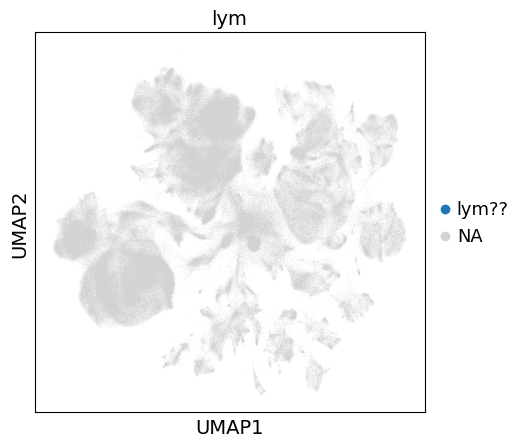

In [463]:
sc.pl.umap(adata,color='lym')

In [464]:
lym.obs['Lineage']='Myeloid lineage'

In [465]:
adata.obs.loc[lym.obs_names,'Lineage'] = lym.obs['Lineage'].astype('object')

#### Myeloid lineage

In [466]:
mye=adata[adata.obs['Lineage']=='Myeloid lineage']

In [467]:
mye

View of AnnData object with n_obs × n_vars = 28982 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType', 'lym'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors', 'lym_colors'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

#### re-cluster

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


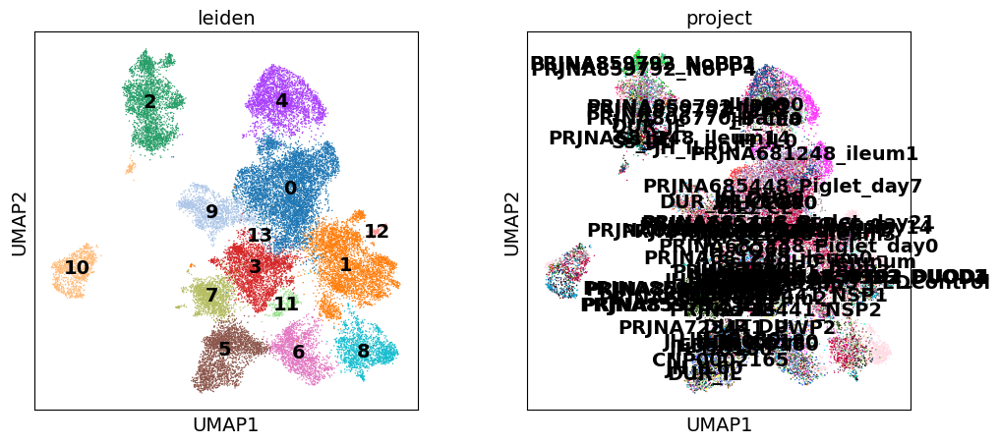

In [468]:
sc.pp.neighbors(mye, use_rep = 'X_scVI')
sc.tl.umap(mye)
sc.tl.leiden(mye, resolution = 0.4)
sc.pl.umap(mye, color=['leiden','project'],legend_loc='on data')

#### macrophage

In [ ]:
# macrophage=['APOE','CST3','C1QA','C1QC']
# macrophage2=['CD68','C1QA','C1QB']#巨噬细胞 

CD68 is in mye.var_names
APOE is in mye.var_names
C1QA is in mye.var_names
C1QB is in mye.var_names
C1QC is in mye.var_names


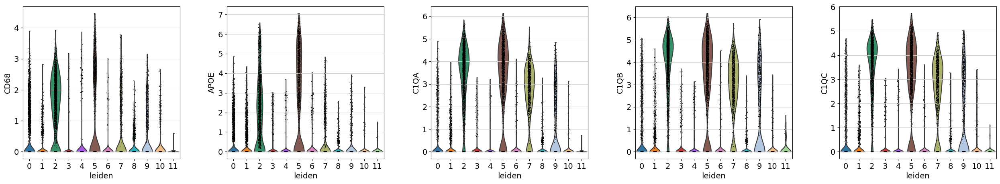

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


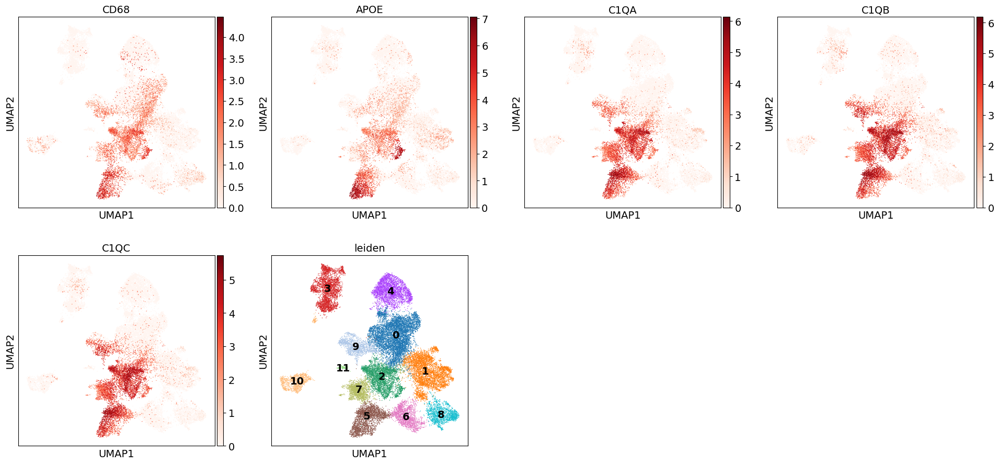

In [ ]:
Glist=['CD68','APOE','C1QA','C1QB','C1QC']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### monocyte

CD14 is in mye.var_names
S100A4 is in mye.var_names
S100A6 is in mye.var_names


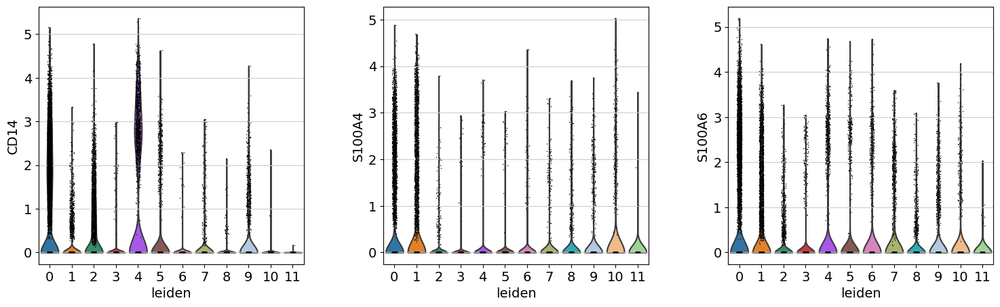

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


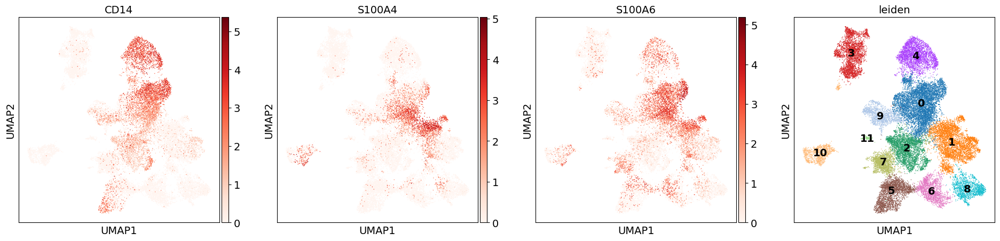

In [ ]:
Glist=['CD14','S100A4', 'S100A6']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

CEBPB is in mye.var_names
S100A12 is in mye.var_names
ENSSSCG00000029414 is in mye.var_names


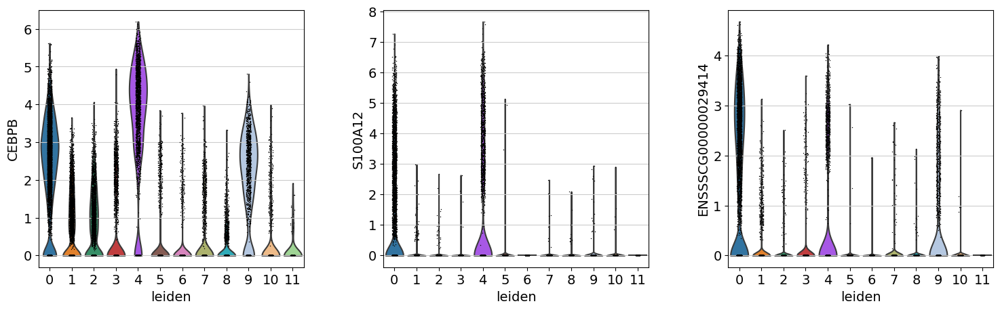

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


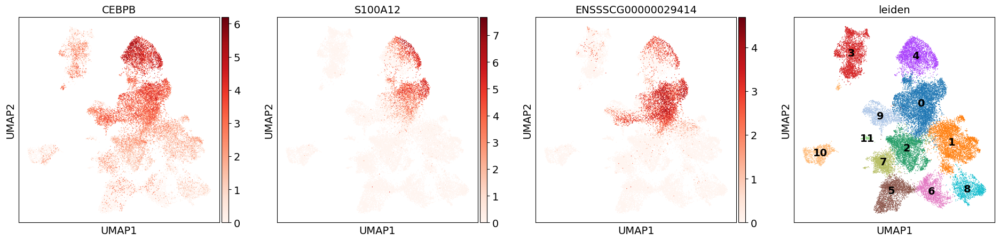

In [ ]:
Glist=['CEBPB','S100A12','ENSSSCG00000029414']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### Dendritic

LTA4H is in mye.var_names
RETN is in mye.var_names
CEBPE is in mye.var_names
GSN is in mye.var_names


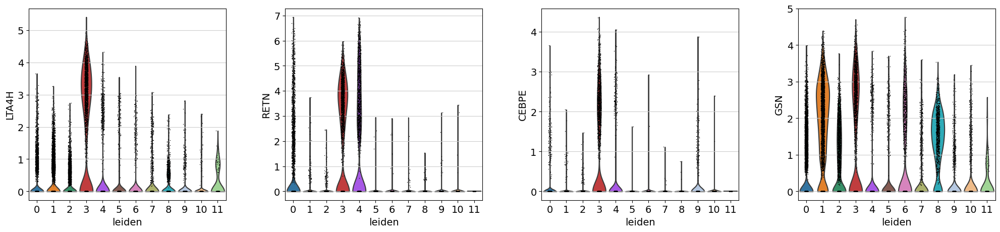

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


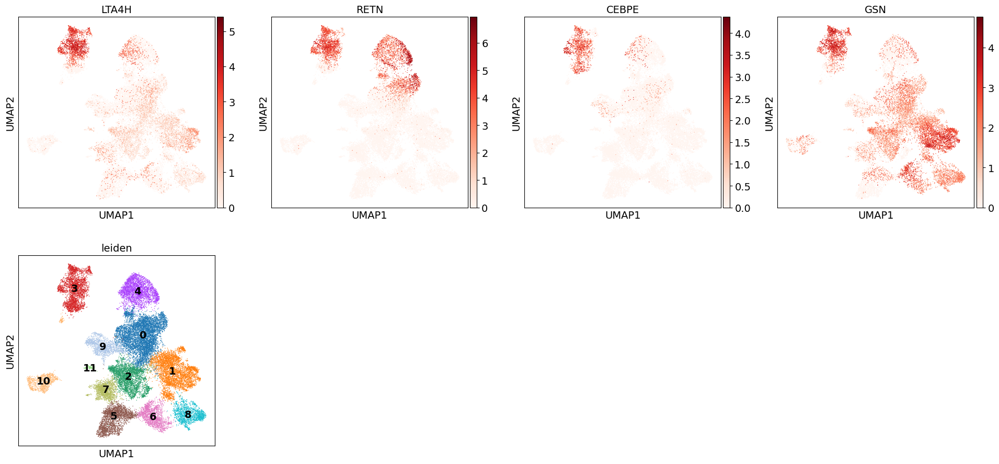

In [ ]:
Glist=['LTA4H','RETN','CEBPE','GSN']
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

HLA-DRA is in mye.var_names
SLA-DQB1 is in mye.var_names
FCER1A is in mye.var_names
CD1E is in mye.var_names


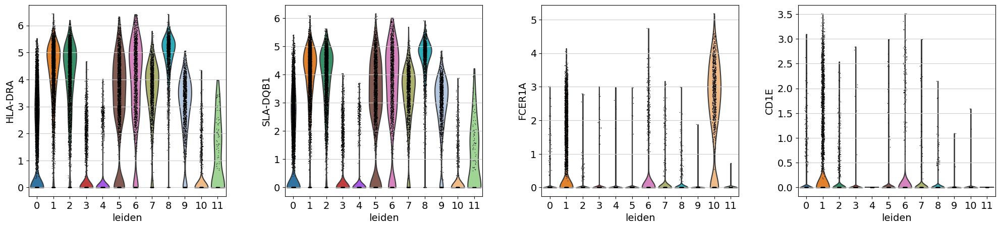

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


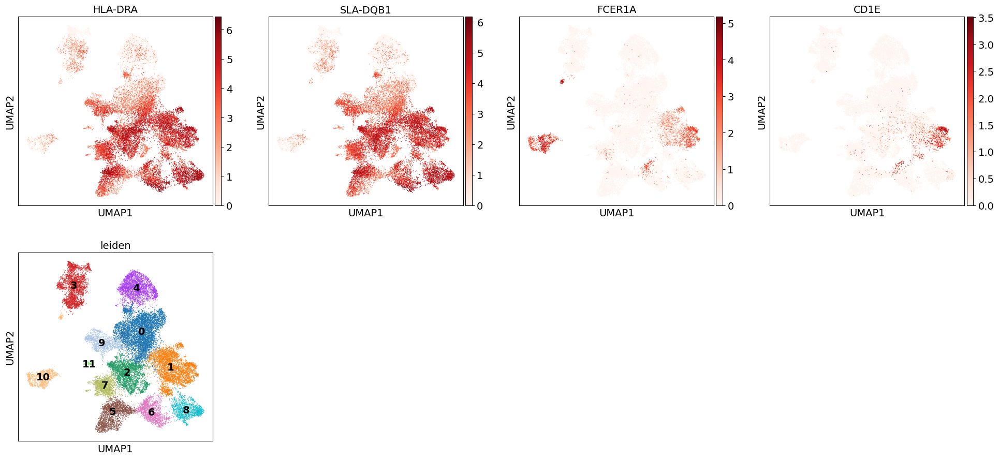

In [ ]:
Glist=['HLA-DRA','SLA-DQB1','FCER1A','CD1E']#DENDRITIC2
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

XCR1 is in mye.var_names
SNX22 is in mye.var_names


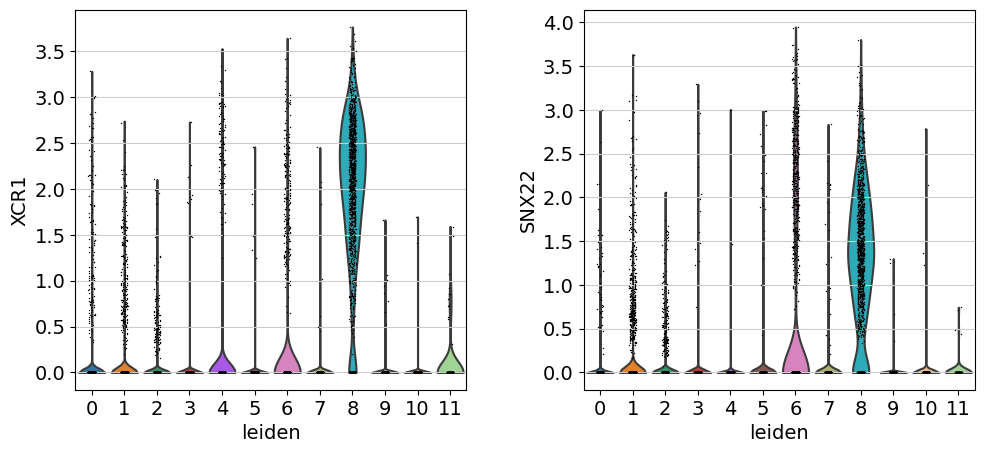

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


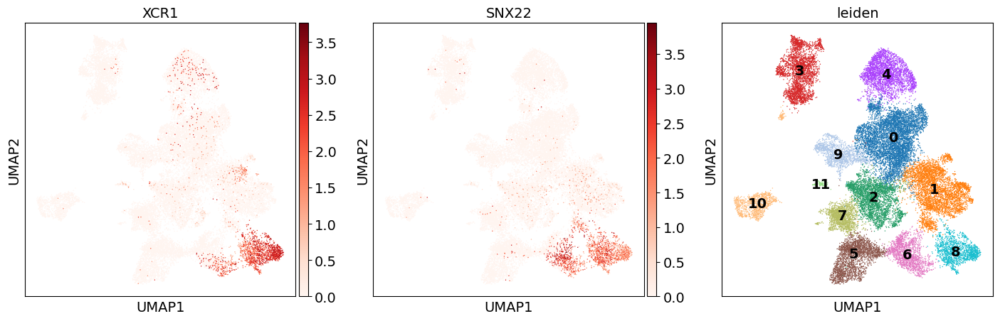

In [ ]:
Glist=['XCR1','SNX22']#DENDRITIC3
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### Mast

MCT7 is not in mye.var_names
LTC4S is in mye.var_names
CCN3 is in mye.var_names
LMNA is in mye.var_names
MS4A2 is in mye.var_names


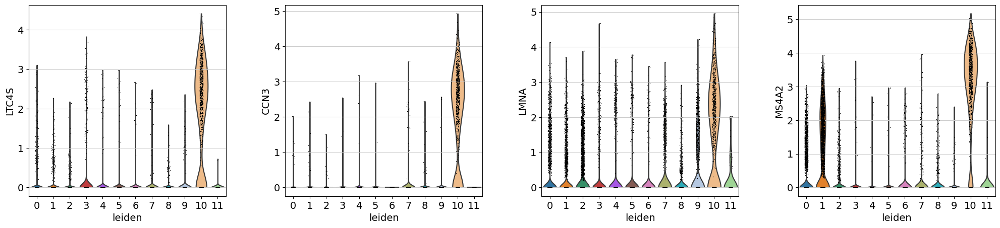

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


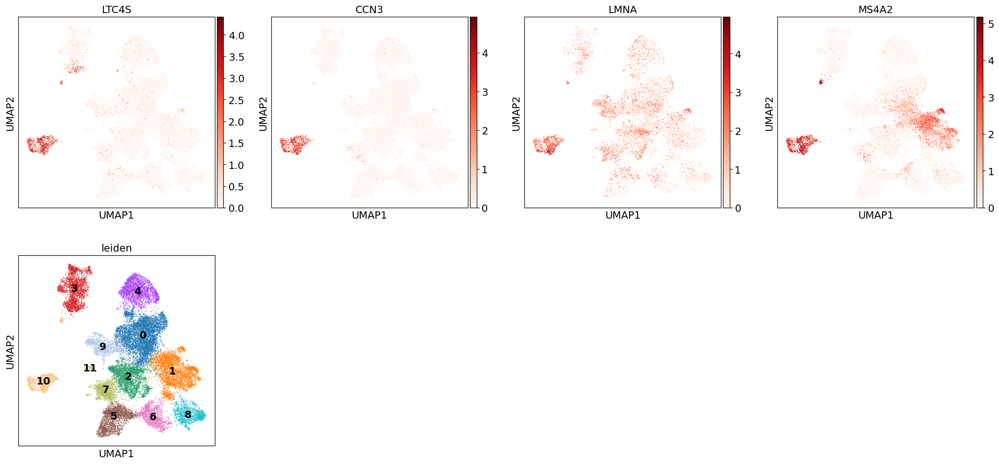

In [ ]:
Glist=['MCT7','LTC4S','CCN3','LMNA','MS4A2']#MAST
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### plasmacytoid DCs

ENSSSCG00000010077 is in mye.var_names
VPREB1 is in mye.var_names
JCHAIN is in mye.var_names
IRF7 is in mye.var_names
MZB1 is in mye.var_names


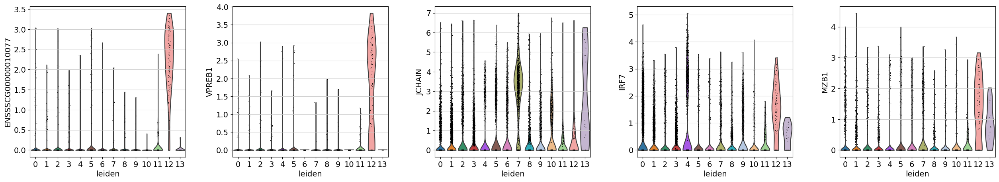

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


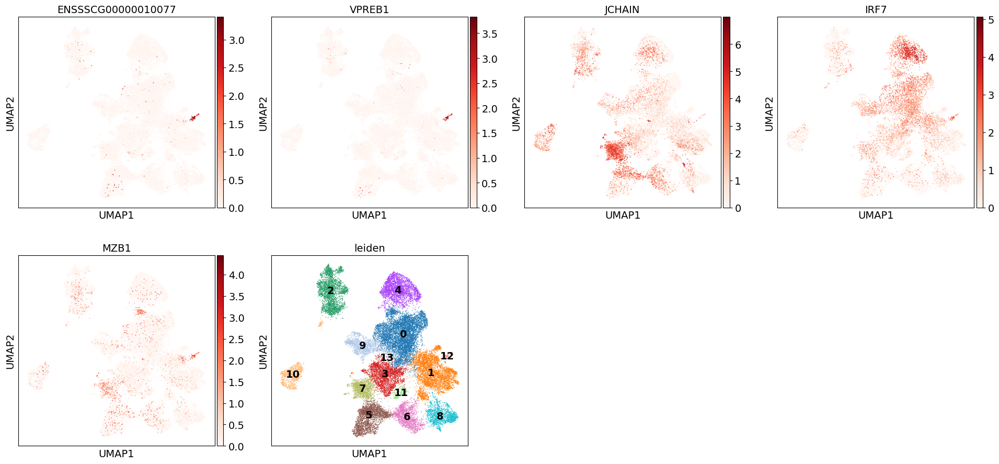

In [469]:
Glist=['ENSSSCG00000010077','VPREB1', 'JCHAIN','IRF7','MZB1']#plasmacytoid DCs
for i in Glist[:]:
    if i  in mye.var_names:
        print(i+' is in mye.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mye.var_names')
sc.pl.violin(mye, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mye, color=Glist,legend_loc='on data')

#### annotation

In [470]:
def function(a):
    if a in ['3','5','7','9','11','13']:
        return "Macrophage"
    elif a in ['0','4']:
        return "Monocyte"
    elif a in ['2','6','8']:
        return "Dendritic"
    elif a in ['10']:
        return "Mast"
    elif a in ['12']:
        return "Plasmacytoid DCs"
    elif a in ['1']:
        return "mass"
df = mye.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mye.obs=df 
#跨列操作，与axis=0对应

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


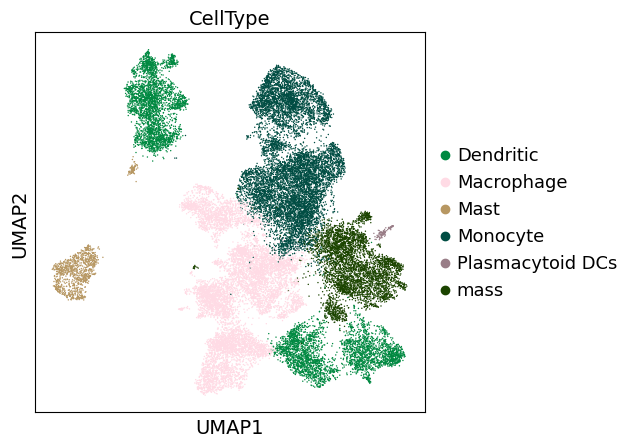

In [471]:
sc.pl.umap(mye, color=["CellType"])

#### mass

##### mass_mono

In [472]:
mass=mye[mye.obs['CellType']=='mass']

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/tools/_leiden.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_added] = pd.Categorical(
/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


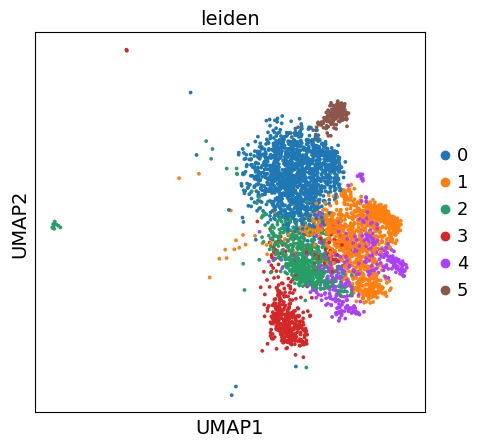

In [473]:
sc.tl.leiden(mass,resolution = 0.3)
sc.pl.umap(mass,color='leiden')

S100A4 is in mass.var_names
S100A6 is in mass.var_names


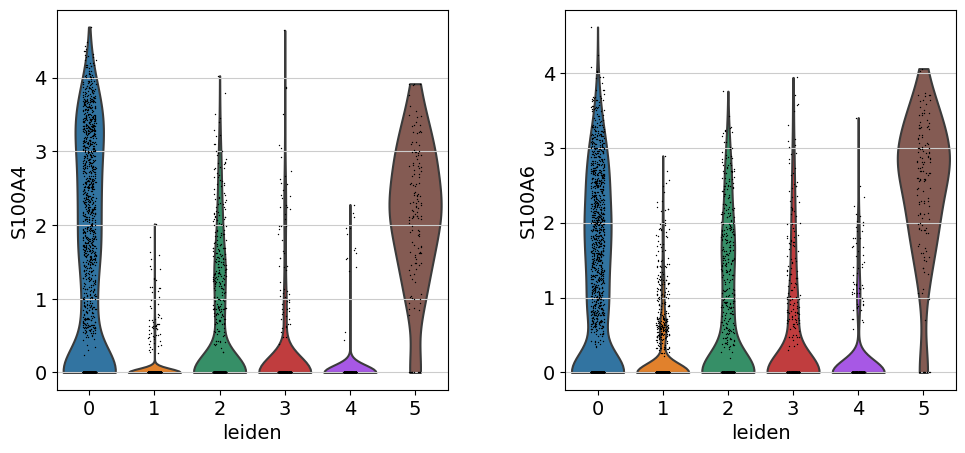

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


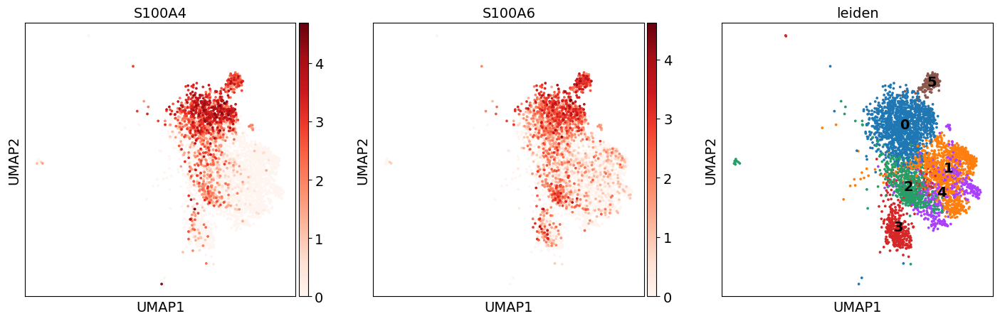

In [474]:
Glist=['S100A4', 'S100A6']#monocyte
for i in Glist[:]:
    if i  in mass.var_names:
        print(i+' is in mass.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mass.var_names')
sc.pl.violin(mass, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mass, color=Glist,legend_loc='on data')

##### mass_dentritic

FCER1A is in mass.var_names
CD1E is in mass.var_names


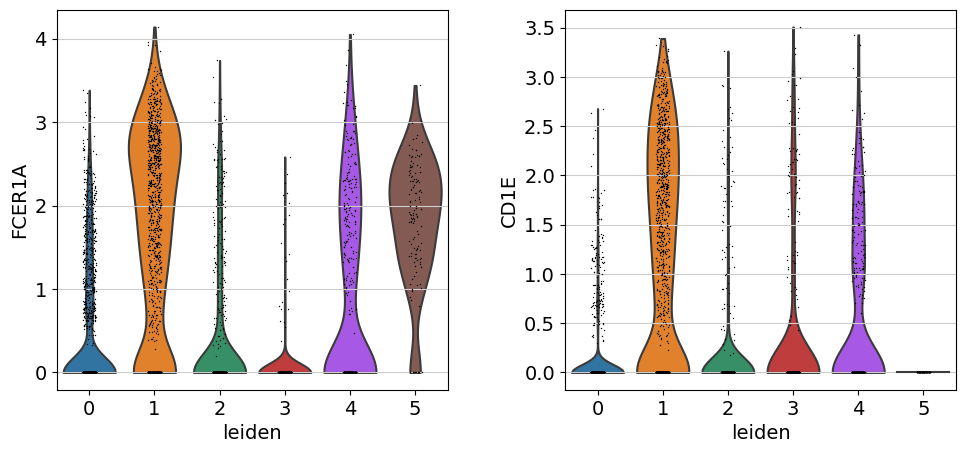

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


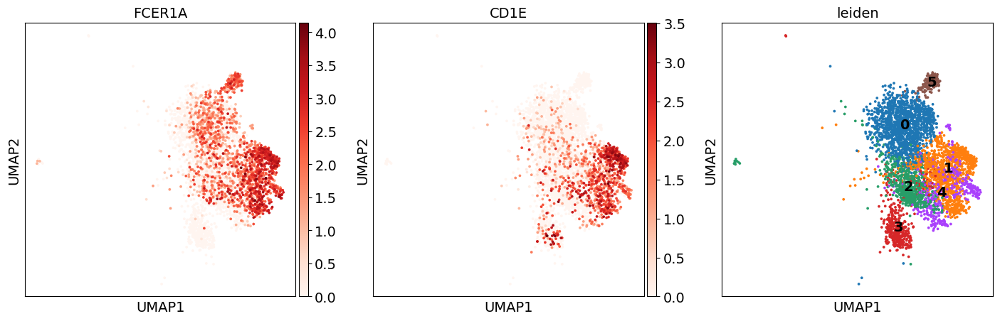

In [475]:
Glist=['FCER1A','CD1E']#dentritic
for i in Glist[:]:
    if i  in mass.var_names:
        print(i+' is in mass.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in mass.var_names')
sc.pl.violin(mass, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(mass, color=Glist,legend_loc='on data')

##### mass_annotation

In [476]:
def function(a):
    if a in ['1','2','3','4']:
        return "Dendritic"
    elif a in ['0','5']:
        return "Monocyte"
df = mass.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mass.obs=df 
#跨列操作，与axis=0对应

In [477]:
mye.obs.loc[mass.obs_names,'CellType'] = mass.obs['CellType'].astype('object')
# mye.obs['CellType'] = mye.obs['CellType'].cat.remove_unused_categories()

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


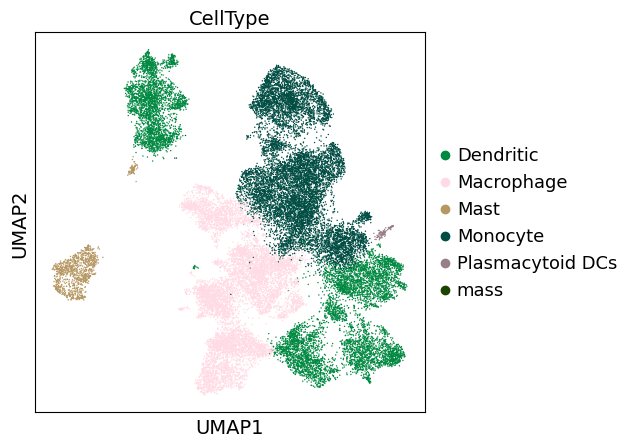

In [481]:
sc.pl.umap(mye, color=["CellType"])

In [482]:
mye.write('./mye.h5ad')

#### ingest to adata

In [483]:
adata.obs['CellType'] = adata.obs['CellType'].astype(str)
adata_celltypes = np.unique(adata.obs['CellType'])
mye_celltypes = np.unique(mye.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(mye_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [484]:
adata.obs.loc[mye.obs_names,'CellType'] = mye.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


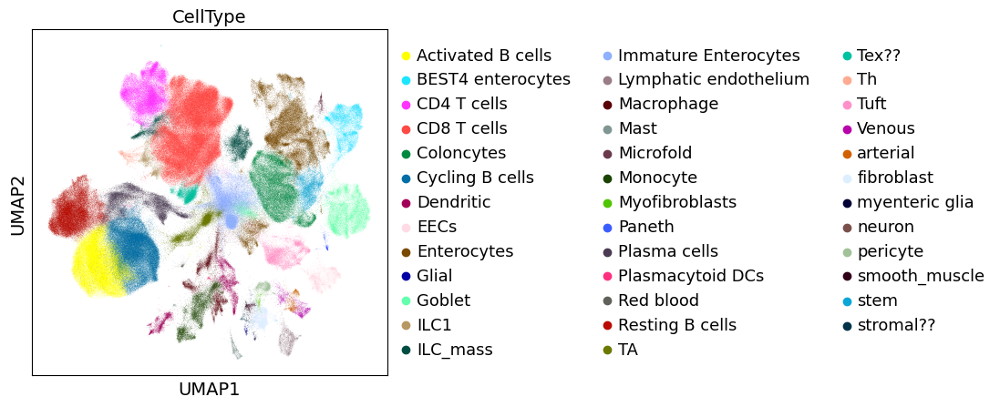

In [485]:
sc.pl.umap(adata,color='CellType')

### reorder

In [507]:
adata.obs['Lineage'].cat.categories.tolist()

['Epithelial lineage',
 'B lineage',
 'T/ILC lineage',
 'Myeloid lineage',
 'Endothelial lineage',
 'Mesenchymal lineage',
 'Red blood',
 'Neuron Lineage']

In [545]:
# adata.obs['Lineage'].cat.categories.tolist()
oreder=['Epithelial lineage',
'B lineage',
'T/ILC lineage',
'Myeloid lineage',
'Endothelial lineage',
'Mesenchymal lineage',
'Neuron Lineage',
 'Red blood']
adata.obs['Lineage']=pd.Categorical(adata.obs['Lineage'],categories=oreder)

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


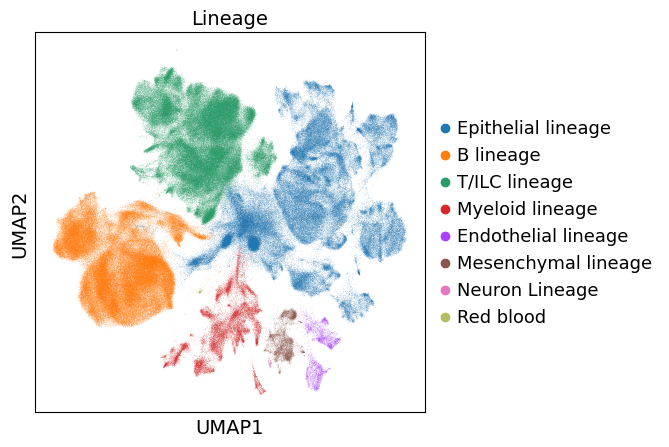

In [511]:
sc.pl.umap(adata,color='Lineage')

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


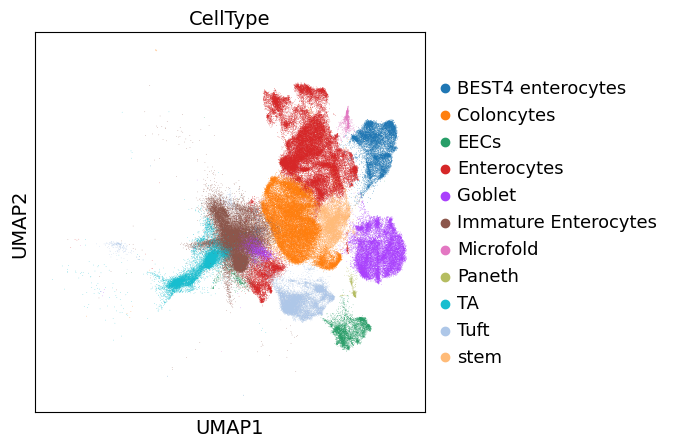

In [513]:
sc.pl.umap(epi,color='CellType')

In [531]:
cell=[]
for i in [epi,B,T,mye,endo,mes,neu,red]:
    a=i.obs['CellType'].cat.categories.tolist()
    cell=cell+a

In [532]:
cell

['BEST4 enterocytes',
 'Coloncytes',
 'EECs',
 'Enterocytes',
 'Goblet',
 'Immature Enterocytes',
 'Microfold',
 'Paneth',
 'TA',
 'Tuft',
 'stem',
 'Activated B cells',
 'Cycling B cells',
 'Plasma cells',
 'Resting B cells',
 'CD4 T cells',
 'CD8 T cells',
 'ILC1',
 'ILC_mass',
 'Tex??',
 'Th',
 'Dendritic',
 'Macrophage',
 'Mast',
 'Monocyte',
 'Plasmacytoid DCs',
 'Lymphatic endothelium',
 'Venous',
 'arterial',
 'Myofibroblasts',
 'fibroblast',
 'myenteric glia',
 'pericyte',
 'smooth_muscle',
 'stromal??',
 'Glial',
 'neuron',
 'Red blood']

In [534]:
cell=['stem',
  'TA',
  'Immature Enterocytes',
  'Enterocytes',
 'Coloncytes',
 'BEST4 enterocytes',
 'EECs',
 'Goblet',
 'Microfold',
 'Paneth',
 'Tuft',
 'Activated B cells',
 'Cycling B cells',
  'Resting B cells',
 'Plasma cells',
 'CD4 T cells',
 'CD8 T cells',
 'Tex??',
 'Th',
  'ILC1',
 'ILC_mass',
 'Macrophage',
 'Mast',
 'Monocyte',
 'Dendritic',
 'Plasmacytoid DCs',
 'arterial',
 'Venous',
 'Lymphatic endothelium',
 'Myofibroblasts',
 'fibroblast',
 'smooth_muscle',
 'myenteric glia',
 'pericyte',
 'stromal??',
 'Glial',
 'neuron',
 'Red blood']

In [537]:
adata.obs['CellType']=pd.Categorical(adata.obs['CellType'],categories=cell)

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


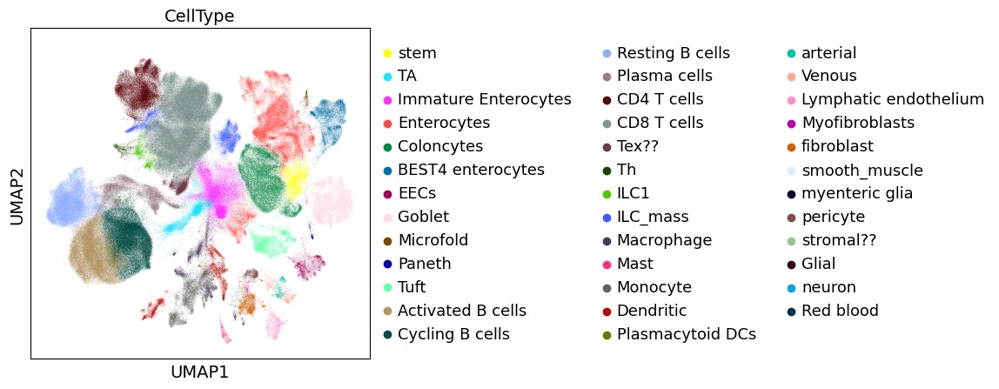

In [538]:
sc.pl.umap(adata,color='CellType')

In [541]:
sc.tl.tsne(adata, use_rep='X_scVI')

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7fa91803a430>
Traceback (most recent call last):
  File "/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
  File "/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
  File "/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
AttributeError: 'NoneType' object has no attribute 'split'


/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


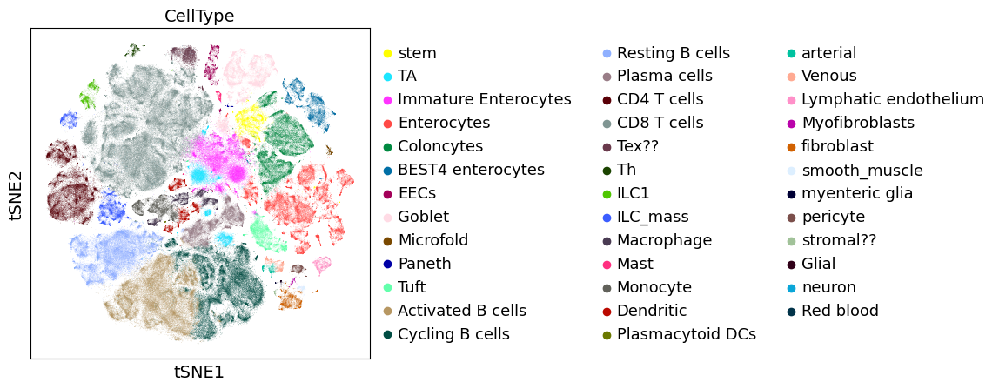

In [542]:
sc.pl.tsne(adata,color='CellType')

In [543]:
adata.write(level2_annotation_file)

categories: Epithelial lineage, B lineage, T/ILC lineage, etc.
var_group_labels: Epithelial, Red blood, Myeloid, etc.


/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


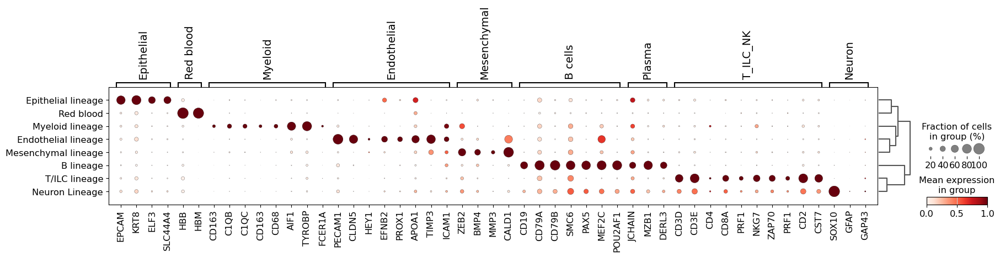

In [548]:
# sc.tl.rank_genes_groups(adata, 'Lineage',key_added='rank_genes_groups_Lineage')
marker_genes_dict = {
    'Epithelial':['EPCAM','KRT8','ELF3','SLC44A4'],
    'Red blood':['HBB','HBM'],
    'Myeloid':['CD163','C1QB','C1QC','CD163','CD68','AIF1','TYROBP','FCER1A'],
    'Endothelial':['PECAM1','CLDN5','HEY1','EFNB2','PROX1','APOA1','TIMP3','ICAM1'],
    'Mesenchymal':['ZEB2','BMP4','MMP3','CALD1'],
    'B cells': ['CD19','CD79A','CD79B','SMC6','PAX5','MEF2C','POU2AF1'],
    'Plasma':['JCHAIN','MZB1','DERL3'],
    'T_ILC_NK': ['CD3D','CD3E','CD4','CD8A','PRF1','NKG7','ZAP70','PRF1','CD2','CST7'],
    'Neuron':['SOX10','GFAP','GAP43']
   
}
sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

In [549]:
adata

AnnData object with n_obs × n_vars = 589101 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'project', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType', 'lym'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'umap', 'CellType_colors', 'lym_colors', 'tsne', 'rank_genes_groups_Lineage', 'dendrogram_Lineage'
    obsm: 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', 'X_tsne', 'X_pca'
    obsp: 'connectivities', 'distances'